In [1]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import matplotlib.patches as patches
import matplotlib.gridspec as gridspec
import time
from tensorflow.python.layers.base import Layer

/opt/conda/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: compiletime version 3.5 of module 'tensorflow.python.framework.fast_tensor_util' does not match runtime version 3.6
  return f(*args, **kwds)
/opt/conda/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
def make_toy_dataset_old(num_samples,noise):
    cir_sample=num_samples*2//3
    circle_circ_x = np.cos(np.linspace(0, np.pi, cir_sample))
    circle_circ_y = np.sin(np.linspace(0, np.pi, cir_sample))
    norm_sample=num_samples-cir_sample
    norm_circ_x = np.zeros(norm_sample)
    norm_circ_y = np.zeros(norm_sample)
    X=np.vstack((np.append(circle_circ_x,norm_circ_x),np.append(circle_circ_y,norm_circ_y))).T
    X += np.random.randn(X.shape[0],X.shape[1])*noise
    index=np.arange(num_samples)
    np.random.shuffle(index)
    return X[index,:]

def make_toy_dataset(num_samples,noise):
    circle_circ_x = np.cos(np.linspace(0, np.pi, num_samples))
    circle_circ_y = np.sin(np.linspace(0, np.pi, num_samples))
    X=np.vstack((circle_circ_x,circle_circ_y)).T
    X += np.random.randn(X.shape[0],X.shape[1])*noise
    index=np.arange(num_samples)
    np.random.shuffle(index)
    return X[index,:]

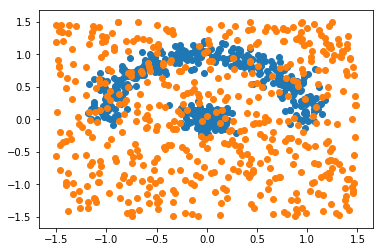

In [3]:
X_true=make_toy_dataset_old(500,0.1)
X_fake=np.random.uniform(low=-1.5,high=1.5,size=(500,2))
plt.scatter(X_true[:,0],X_true[:,1])
plt.scatter(X_fake[:,0],X_fake[:,1])
plt.show()

In [4]:
'''
**************************************************************************************************************
Problem: this model try to predict everything sample as positive to minimize loss
potential solution: saparate into two step: first freeze VAE, optimize classifier. Then optimize VAE
plan B: train a global classifier to classify true sample and uniform random noise(cover all true sample),
then freeze classifier, increase score of VAE output
**************************************************************************************************************
'''

tf.reset_default_graph()
X=tf.placeholder(dtype=tf.float32,shape=[None,2])
y=tf.placeholder(dtype=tf.int32,shape=[None])

mask_psed_neg=tf.reshape(tf.cast(tf.equal(y,1),tf.float32),(-1,1))
mask_not_psed_neg=tf.reshape(tf.cast(tf.logical_not(tf.equal(y,1)),tf.float32),(-1,1))

y_onehot=tf.one_hot(y,3)
eps=1e-10

class Classifier(Layer):
    def __init__(self):
        self.linear1=tf.layers.Dense(units=256,name='linear1',activation=tf.nn.relu,_reuse=tf.AUTO_REUSE)
        self.linear2=tf.layers.Dense(units=256,name='linear2',activation=tf.nn.relu,_reuse=tf.AUTO_REUSE)
        self.linear3=tf.layers.Dense(units=256,name='linear3',activation=tf.nn.relu,_reuse=tf.AUTO_REUSE)
        self.linear4=tf.layers.Dense(units=3,name='linear4',_reuse=tf.AUTO_REUSE)
    
    def __call__(self,inputs):
        score=self.linear4(self.linear3(self.linear2(self.linear1(inputs))))
        return score
    
class VAE(Layer):
    def __init__(self):
        self.lstm_hidden_dim=20
        self.latent_dim=10
        self.n_time=4
        self.encoder_lstm=tf.contrib.rnn.LSTMCell(self.lstm_hidden_dim)
        self.decoder_lstm=tf.contrib.rnn.LSTMCell(self.lstm_hidden_dim)
        self.encode_mean=tf.layers.Dense(units=self.latent_dim,name='encode_mean')   # calculate mean of z
        self.encode_std=tf.layers.Dense(units=self.latent_dim,name='encode_std')   # calculate std of z
        self.unit_gaussian=tf.distributions.Normal(loc=tf.zeros(self.latent_dim),scale=tf.ones(self.latent_dim)*5.0)
        self.emit_net=tf.layers.Dense(units=2,name='emit_net')
        
    def __call__(self,inputs):
        batch_size=tf.shape(inputs)[0]
        state_encode=self.encoder_lstm.zero_state(batch_size, tf.float32)   # lstm tuple (c,h)
        state_decode=self.decoder_lstm.zero_state(batch_size, tf.float32)   # lstm tuple (c,h)
        original_image=tf.layers.flatten(inputs)
        output_image=None
        latent_loss_his=[]
        classifier_loss_his=[]
        likelihood_his=[]
        predict_his=[]
        image_his=[]
        
        for t in range(self.n_time):
            if t==0:
                image=original_image
            else:
                # use output_image for fake images, use original image for real image
                image=mask_psed_neg*output_image+mask_not_psed_neg*original_image
            image_his.append(image)
            '''
            Part I: Classifier
            **************************************************************************************************************
            There is a problem with classifier. 
            During classifing, we only want to train the variables in the classifiers.  (solved)
            During likelihood estimation, we do not want to change the variables in the classifiers. (unsolved)
            **************************************************************************************************************
            '''
            classifier_scope="CNN_classifier_"+str(t)
            input_image=tf.reshape(image,(-1,2))
            with tf.variable_scope(classifier_scope) as vs:
                classifier=Classifier()
                score_likelihood=classifier(input_image)
            with tf.variable_scope(classifier_scope) as vs:
                classifier=Classifier()
                score_classifier=classifier(tf.stop_gradient(input_image))
            
            score_likelihood=tf.reshape(score_likelihood[:,0]-score_likelihood[:,1],(-1,1))*mask_psed_neg
            likelihood_his.append(score_likelihood) # only record score for fake images
            classifier_loss_his.append(tf.losses.softmax_cross_entropy(logits=score_classifier,onehot_labels=y_onehot))
            predict_his.append(score_classifier)
            
            '''
            Part II: Recurrent VAE
            '''
            with tf.variable_scope("LSTM_encoder") as vs:
                encode_out,state_encode=self.encoder_lstm(image,state_encode)
            z_mean=self.encode_mean(encode_out)
            z_std=5.0*tf.exp(self.encode_std(encode_out))
            distrib_encode=tf.distributions.Normal(loc=z_mean,scale=z_std)
            Z=distrib_encode.sample()
            
            latent_loss=tf.reduce_sum(mask_psed_neg*tf.distributions.kl_divergence(distrib_encode,self.unit_gaussian),axis=1)
            latent_loss_his.append(latent_loss)
            
            with tf.variable_scope("LSTM_decoder") as vs:
                decode_out,state_decode=self.decoder_lstm(Z,state_decode)
                
            output_image=self.emit_net(decode_out)
            
        tot_latent_loss=tf.reduce_mean(latent_loss_his)
        tot_classifier_loss=tf.reduce_mean(classifier_loss_his)
        tot_likelihood_loss=tf.reduce_sum(likelihood_his,axis=0)  # accumulate score through time
#         tot_likelihood_loss=tf.reduce_mean(-tf.nn.sigmoid(tot_likelihood_loss))
        tot_likelihood_loss=tf.reduce_mean(-tot_likelihood_loss)
        
        tot_loss=tot_latent_loss+tot_classifier_loss+tot_likelihood_loss
            
        return image_his,tot_loss,tot_latent_loss,tot_classifier_loss,tot_likelihood_loss,predict_his


vae=VAE()
image_his,tot_loss,tot_latent_loss,tot_classifier_loss,tot_likelihood_loss,predict_his=vae(X)
tot_classifier_loss=tot_classifier_loss
tot_loss2=tot_latent_loss+tot_likelihood_loss

classifier_variables=[]
vae_variables=[]
for v in tf.global_variables():
    if v.name.find('CNN_classifier')!=-1:
        classifier_variables.append(v)
    else:
        vae_variables.append(v)

optimizier=tf.train.AdamOptimizer(learning_rate=1e-2)
train_step1 = optimizier.minimize(tot_classifier_loss,var_list=classifier_variables)
train_step2 = optimizier.minimize(tot_loss2,var_list=vae_variables)

In [5]:
vv0=[v for v in tf.global_variables() if v.name=='CNN_classifier_0/linear1/kernel:0'][0]
vv1=[v for v in tf.global_variables() if v.name=='CNN_classifier_1/linear1/kernel:0'][0]
vv2=[v for v in tf.global_variables() if v.name=='CNN_classifier_2/linear1/kernel:0'][0]
vv3=[v for v in tf.global_variables() if v.name=='CNN_classifier_3/linear1/kernel:0'][0]

new_score=[]

for t in range(4):
    with tf.variable_scope("CNN_classifier_"+str(t)) as vs:
        classifier=Classifier()
        n_score=classifier(X)
        new_score.append(n_score)

In [6]:
with tf.Session() as sess:
    tf.global_variables_initializer().run()
    X_true=make_toy_dataset_old(200,0.1)
    X_true=(X_true-np.array([0,0.5]))/np.array([0.5,0.5])
    X_fake=np.random.uniform(low=-3,high=3,size=(200,2))
    X_noise=np.random.uniform(low=-3,high=3,size=(200,2))
    image=np.vstack((X_true,X_fake,X_noise))
    label=np.concatenate((np.zeros(200),np.ones(200),2*np.ones(200)))
    a=sess.run(predict_his,feed_dict={X:image,y:label})
    b=sess.run(new_score,feed_dict={X:image,y:label})

In [7]:
# for v in tf.global_variables():
#     print(v)

In [8]:
# vv=[v for v in tf.global_variables() if v.name=='CNN_classifier_0/linear1/kernel:0'][0]
# vv2=[v for v in tf.global_variables() if v.name=='CNN_classifier_1/linear1/kernel:0'][0]
# vv3=[v for v in tf.global_variables() if v.name=='encode_mean/kernel:0'][0]
# a=tf.gradients(tot_loss,vv)[0]
# b=tf.gradients(tot_latent_loss,vv)[0]
# c=tf.gradients(tot_classifier_loss,vv)[0]
# d=tf.gradients(tot_likelihood_loss,vv)[0]
# print(a)
# print(b)
# print(c)
# print(d)

# with tf.Session() as sess:
#     tf.global_variables_initializer().run()
#     original0=sess.run(vv)
#     original1=sess.run(vv2)
#     X_true=make_toy_dataset(200,0.1)
#     X_fake=np.random.uniform(low=-1.5,high=1.5,size=(200,2))
#     image=np.vstack((X_true,X_fake))
#     label=np.concatenate((np.ones(200),np.zeros(200)))
#     ga=sess.run(a,feed_dict={X:image,y:label})
#     gc=sess.run(c,feed_dict={X:image,y:label})
#     gd=sess.run(d,feed_dict={X:image,y:label})
#     _=sess.run(train_step,feed_dict={X:image,y:label})
#     latter0=sess.run(vv)
#     latter1=sess.run(vv2)
# #     print(original0-latter0)
# #     print(original1-latter1)

In [9]:
# out1=tf.layers.dense(X,units=20,activation=tf.nn.relu)
# score=tf.layers.dense(out1,units=1)
# prob=tf.nn.sigmoid(score)
# predict=tf.cast(prob>0.5,tf.int32)

# with tf.Session() as sess:
#     tf.global_variables_initializer().run()
#     X_true=make_toy_dataset(200,0.1)
#     X_fake=np.random.uniform(low=-1.5,high=1.5,size=(200,2))
#     image=np.vstack((X_true,X_fake))
#     label=np.concatenate((np.ones(200),np.zeros(200)))
#     p=sess.run(predict,feed_dict={X:image,y:label})
#     print(p.reshape(-1,))
    

In [10]:
def display(i_his,image_id): 
    plt.figure(1)
    h=0.1
    xx, yy = np.meshgrid(
        np.arange(-1.5, 1.5, h),
        np.arange(-1.5, 1.5, h))
    points=np.c_[xx.ravel(), yy.ravel()]
    p_his=sess.run(new_score,feed_dict={X:points,y:np.zeros(points.shape[0])})
    for t in range(4):
        plt.subplot(2,2,t+1)
        Z=np.argmax(p_his[t],axis=1)
        Z=Z.reshape(xx.shape)
#         print('t =',t,Z)
        _=plt.contourf(xx,yy,Z,cmap=plt.cm.coolwarm_r, alpha=0.8)
        plt.scatter(i_his[t][:200,0],i_his[t][:200,1])
        plt.scatter(i_his[t][200:400,0],i_his[t][200:400,1])
#         plt.scatter(i_his[t][400:,0],i_his[t][400:,1])
        plt.axis('off')
        plt.colorbar(_)
    if image_id==0 or (image_id+1)%50==0:
        plt.savefig('figures/toy_dataset_%03d.png' % (image_id+1))
    plt.show()

iteration  0
1.1005404 0.007665248 1.097561 -0.0046858233


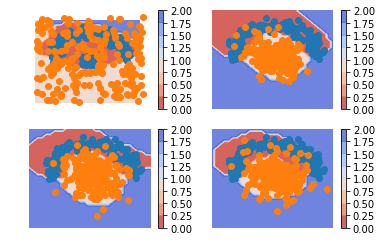

iteration  1
3.3462467 0.0077511217 0.8081768 2.5303187


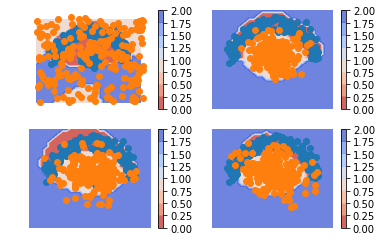

iteration  2
4.047839 0.010193729 0.70503557 3.33261


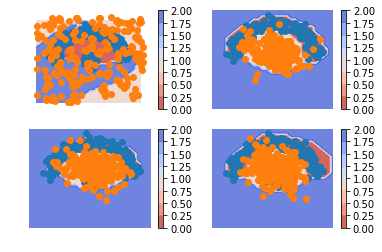

iteration  3
5.8633723 0.01228748 0.66368693 5.187398


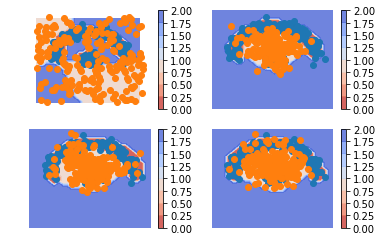

iteration  4
6.4993887 0.01610772 0.6114005 5.8718805


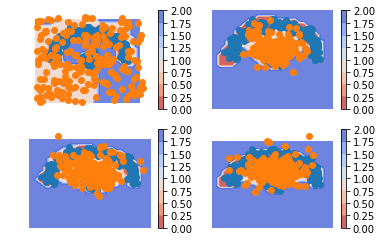

iteration  5
7.4324856 0.02201523 0.65655136 6.753919


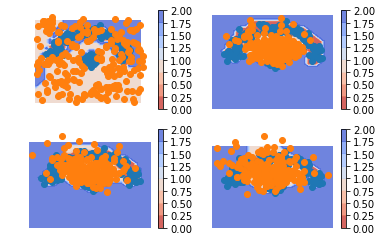

iteration  6
7.3704996 0.028647954 0.6502486 6.691603


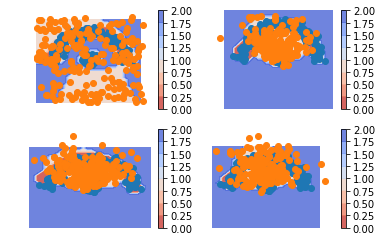

iteration  7
6.234725 0.035741366 0.66227245 5.536711


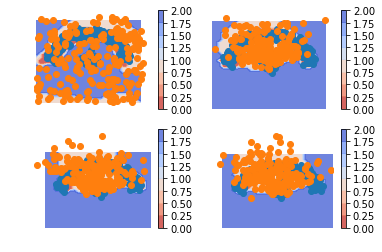

iteration  8
5.2885766 0.036416933 0.67986274 4.572297


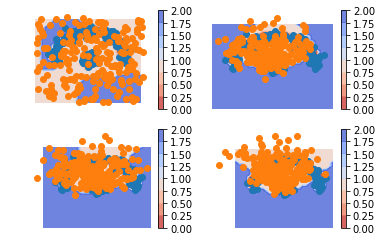

iteration  9
6.3418827 0.031624652 0.68484485 5.625413


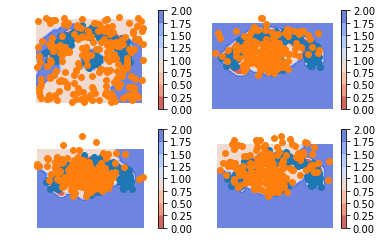

iteration  10
7.099003 0.02874764 0.7049803 6.365275


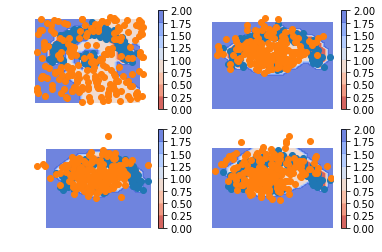

iteration  11
6.8707275 0.027529946 0.7245076 6.11869


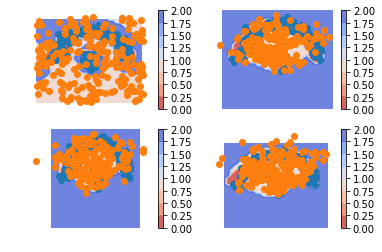

iteration  12
5.6232004 0.025225146 0.7109494 4.887026


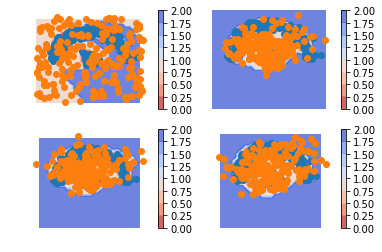

iteration  13
6.1921434 0.024033176 0.67798126 5.490129


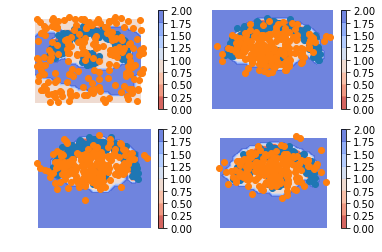

iteration  14
7.9062786 0.023677722 0.63865364 7.243947


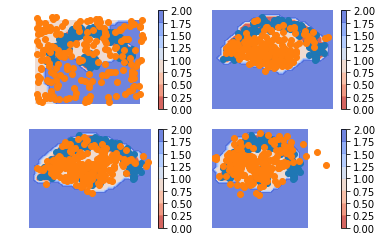

iteration  15
7.28464 0.022299198 0.6877928 6.574548


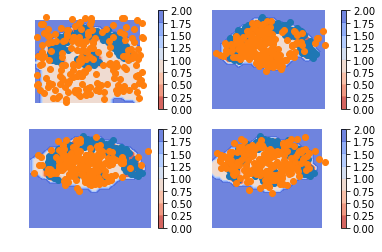

iteration  16
6.082558 0.022064148 0.68802214 5.372472


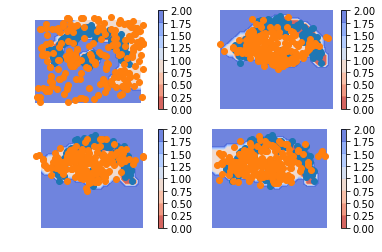

iteration  17
5.935441 0.022906406 0.6838671 5.2286677


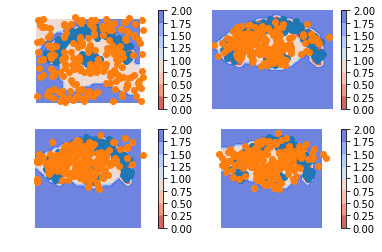

iteration  18
6.9869123 0.022993118 0.68331444 6.280605


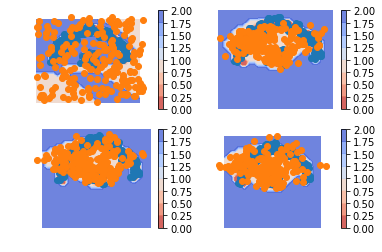

iteration  19
8.303649 0.022701565 0.67997444 7.600973


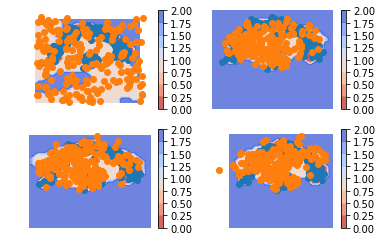

iteration  20
7.524485 0.021005105 0.6621115 6.8413687


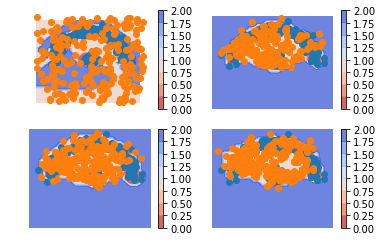

iteration  21
7.5190434 0.021268569 0.708747 6.7890277


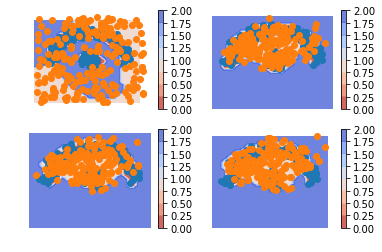

iteration  22
7.569683 0.02117092 0.6723141 6.876198


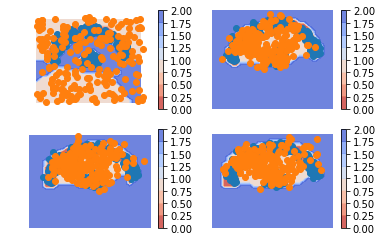

iteration  23
9.587768 0.02144333 0.7064442 8.85988


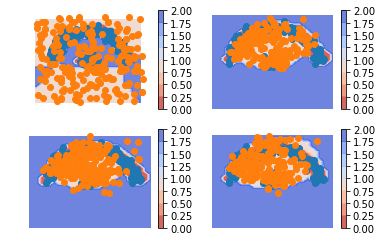

iteration  24
7.1580772 0.022411747 0.70824575 6.4274197


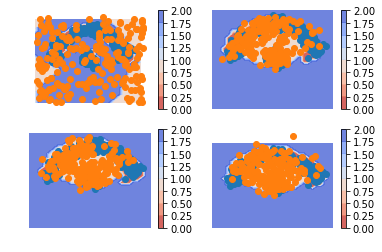

iteration  25
4.5280952 0.022417504 0.6860986 3.8195794


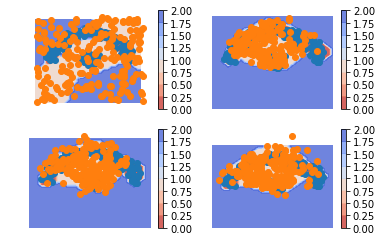

iteration  26
4.5722914 0.024182495 0.7062795 3.8418295


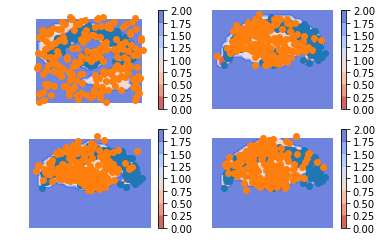

iteration  27
3.7835078 0.02507051 0.69180256 3.066635


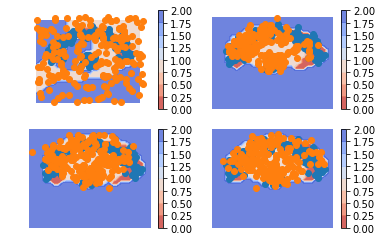

iteration  28
5.473711 0.026767226 0.7531223 4.6938214


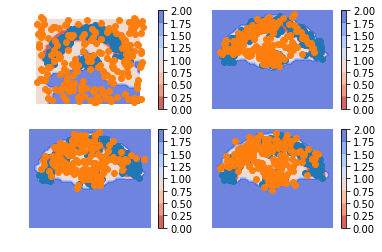

iteration  29
4.529557 0.027744351 0.69264525 3.8091674


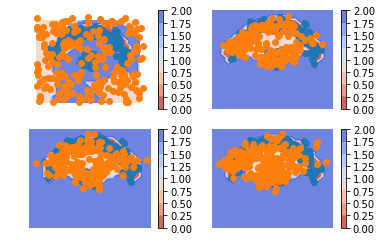

iteration  30
3.6845114 0.028689029 0.71152335 2.944299


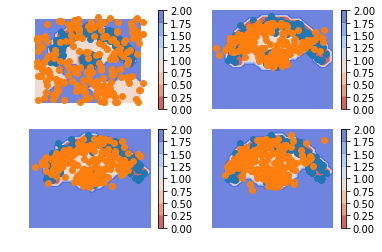

iteration  31
3.4768913 0.028842792 0.75485307 2.6931953


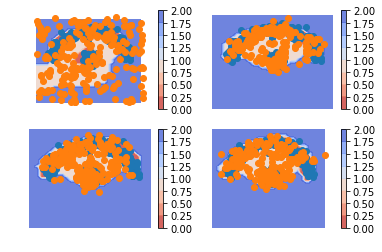

iteration  32
4.6714816 0.032249272 0.7011161 3.938116


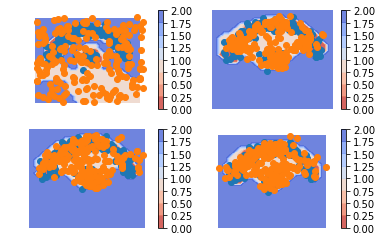

iteration  33
4.5385013 0.033955984 0.7156327 3.7889128


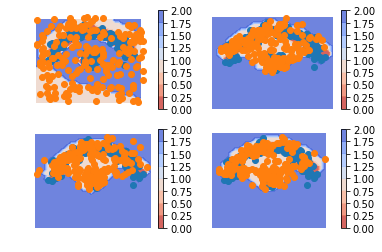

iteration  34
4.545773 0.03825024 0.7205874 3.7869356


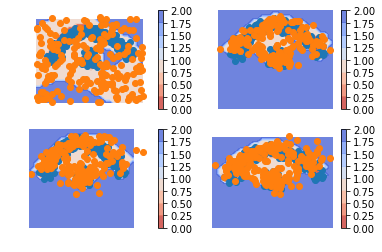

iteration  35
4.8750806 0.03655024 0.7103095 4.128221


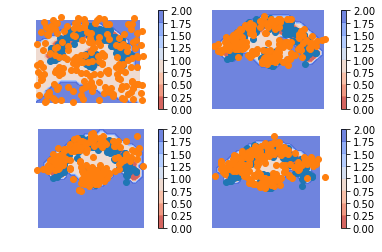

iteration  36
4.8581886 0.03316696 0.68424284 4.140779


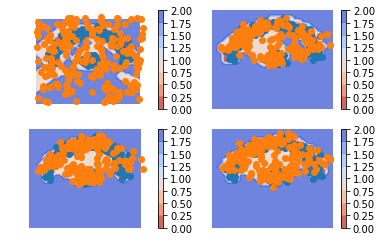

iteration  37
6.089546 0.032375343 0.75528985 5.301881


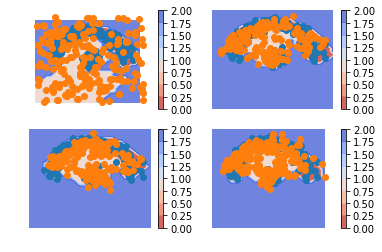

iteration  38
5.807473 0.03104352 0.731508 5.044922


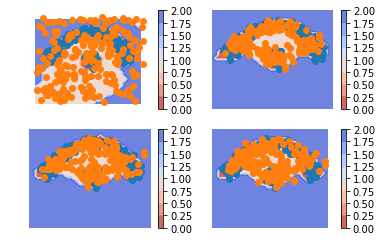

iteration  39
6.079776 0.033405438 0.75214875 5.2942214


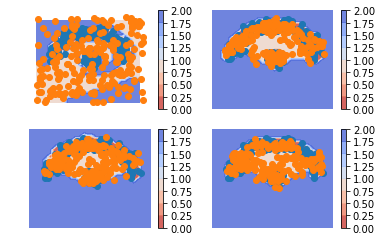

iteration  40
5.7200637 0.033889797 0.73543257 4.9507413


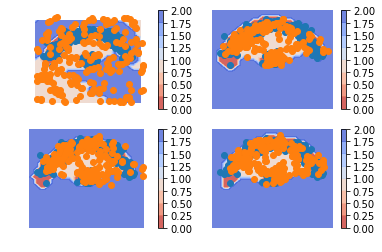

iteration  41
5.7177143 0.032239556 0.697191 4.9882836


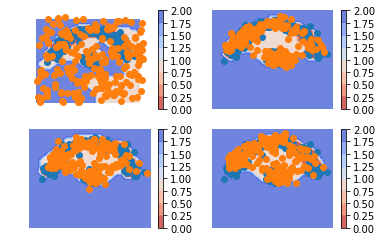

iteration  42
5.6861477 0.029618695 0.7277422 4.9287868


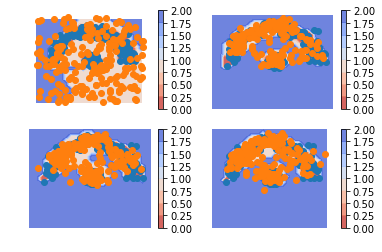

iteration  43
5.862855 0.028067125 0.7296525 5.1051354


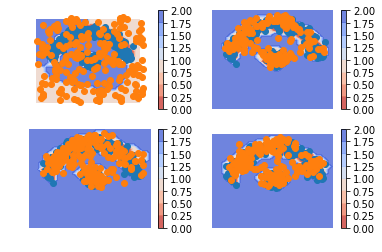

iteration  44
6.4041157 0.026452294 0.76614076 5.6115227


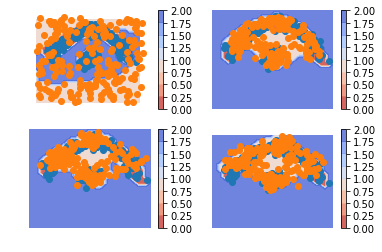

iteration  45
4.5555735 0.023601415 0.73641586 3.7955563


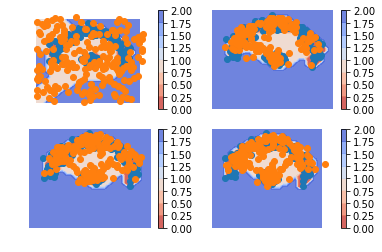

iteration  46
5.459115 0.023708379 0.72928923 4.706117


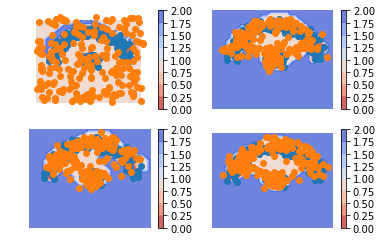

iteration  47
3.821487 0.021370204 0.72217375 3.077943


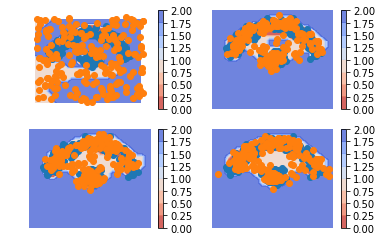

iteration  48
3.9028287 0.020799154 0.7344223 3.147607


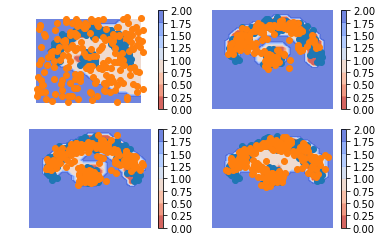

iteration  49
4.865089 0.023850638 0.72504747 4.116191


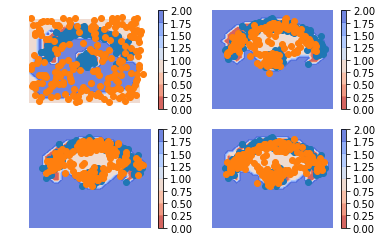

iteration  50
3.7239497 0.02597001 0.75902104 2.9389586


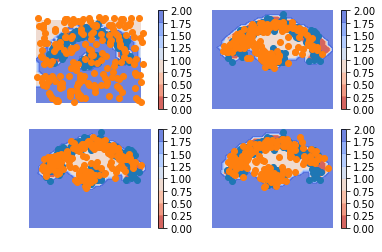

iteration  51
4.0290136 0.030079337 0.7288208 3.2701135


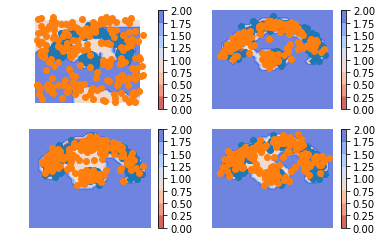

iteration  52
6.62401 0.03210655 0.7451533 5.8467503


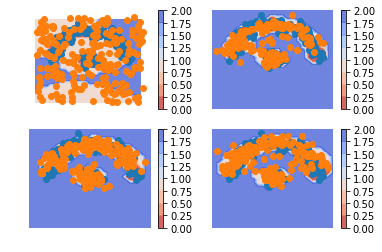

iteration  53
4.875079 0.0330004 0.74323153 4.0988474


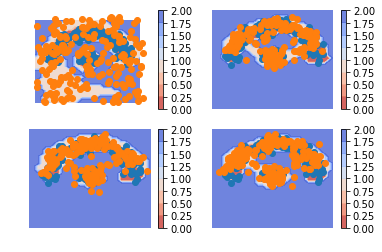

iteration  54
4.9834933 0.030571235 0.70729977 4.245622


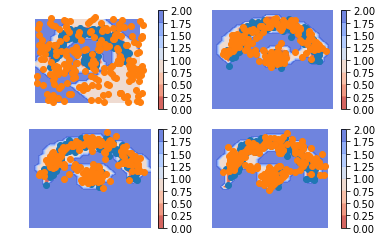

iteration  55
5.8975425 0.028170427 0.73833084 5.131041


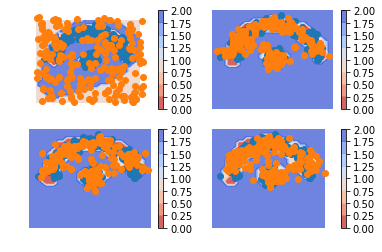

iteration  56
4.7471623 0.024751611 0.7062436 4.016167


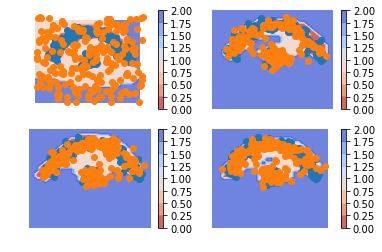

iteration  57
5.5121098 0.022781843 0.7717054 4.7176223


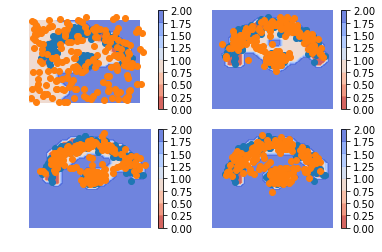

iteration  58
6.1909046 0.021989908 0.7651008 5.403814


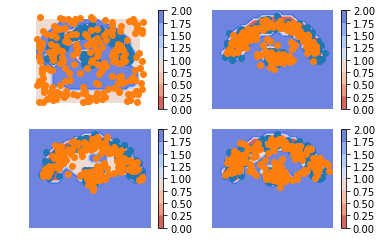

iteration  59
6.0287895 0.021268297 0.7229112 5.28461


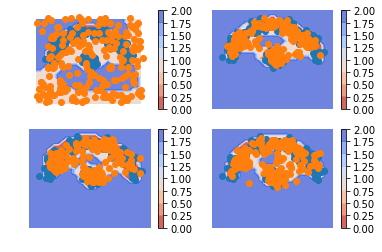

iteration  60
5.6703887 0.021277964 0.75311 4.896001


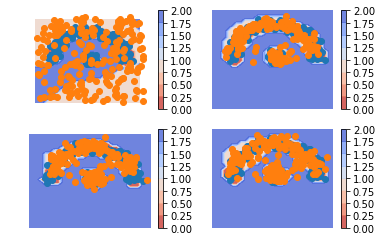

iteration  61
5.7300644 0.022170441 0.72385275 4.984041


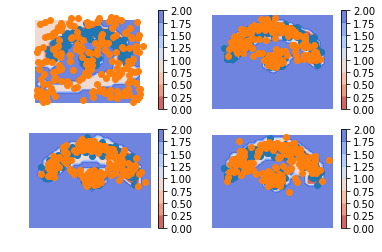

iteration  62
6.442162 0.022650484 0.71716064 5.702351


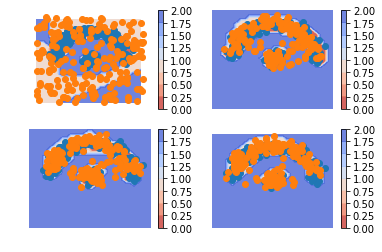

iteration  63
5.965699 0.022699717 0.7299278 5.213072


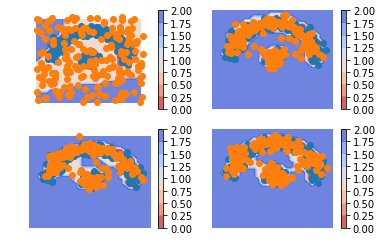

iteration  64
4.9612217 0.022990804 0.770582 4.167649


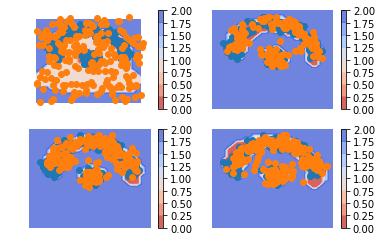

iteration  65
7.116759 0.022733072 0.74989384 6.344132


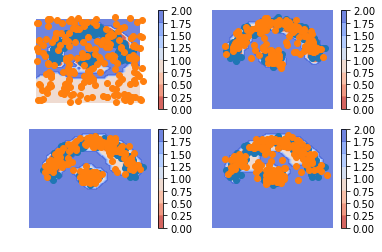

iteration  66
6.5348043 0.021919448 0.7482387 5.764646


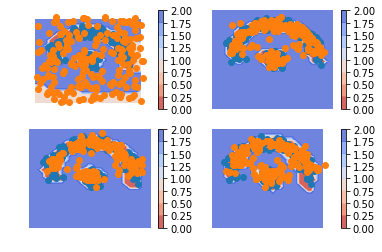

iteration  67
4.868588 0.021496315 0.7283493 4.1187425


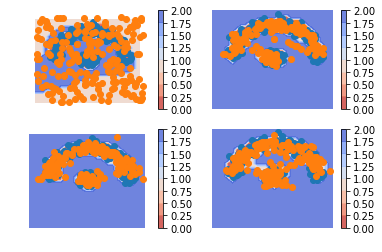

iteration  68
6.8612785 0.020595951 0.6903077 6.150375


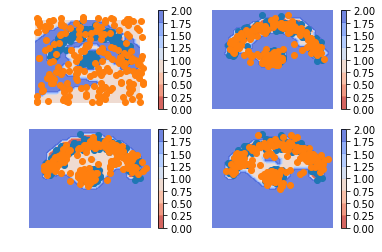

iteration  69
7.0122437 0.019565858 0.7575026 6.235175


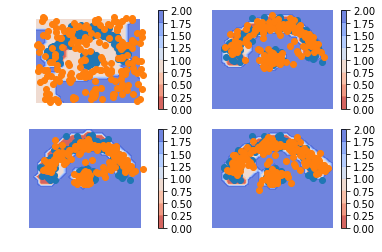

iteration  70
4.269637 0.019234017 0.72597146 3.5244315


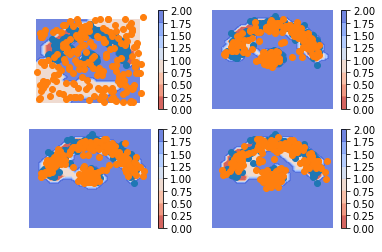

iteration  71
4.966911 0.019017996 0.7060827 4.2418103


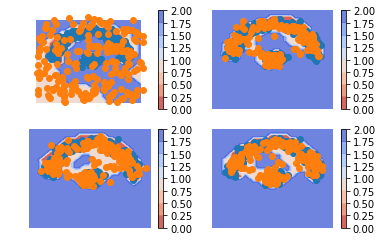

iteration  72
4.6987214 0.019028744 0.7489733 3.9307194


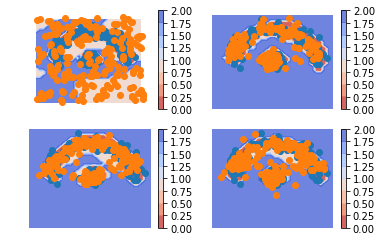

iteration  73
4.2137537 0.019415254 0.72856593 3.4657726


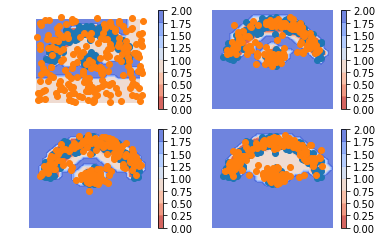

iteration  74
3.7957644 0.018917445 0.74476457 3.0320826


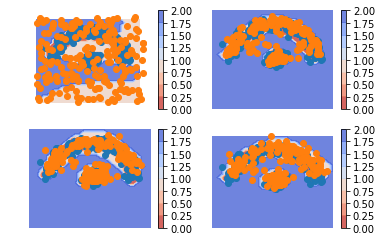

iteration  75
3.1593113 0.01768105 0.71147335 2.430157


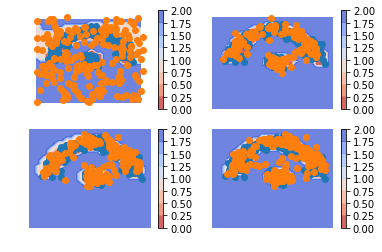

iteration  76
4.1933565 0.016909502 0.7872039 3.3892431


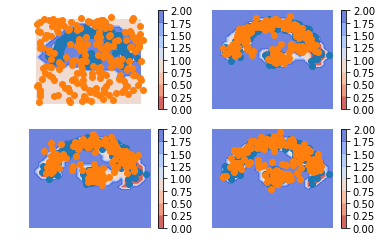

iteration  77
4.0015 0.01636704 0.74449193 3.2406414


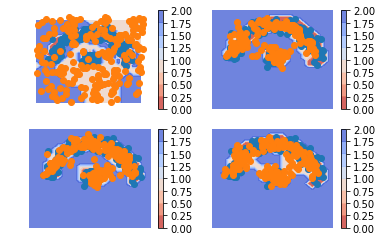

iteration  78
4.473608 0.016623372 0.7292394 3.727745


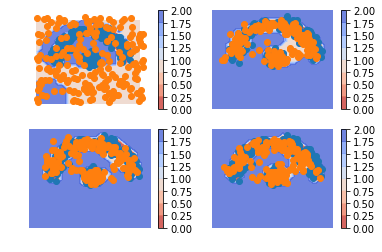

iteration  79
4.024699 0.01742768 0.7062999 3.3009717


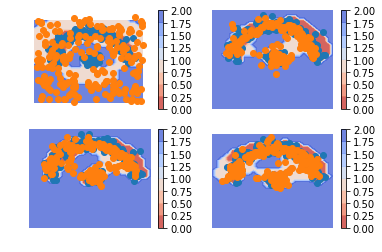

iteration  80
3.3878465 0.019040322 0.72225153 2.6465545


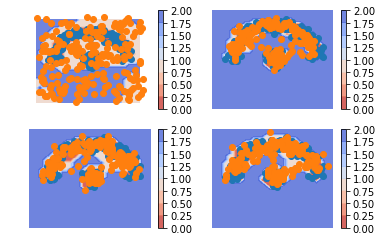

iteration  81
2.6795938 0.02075734 0.7437264 1.9151101


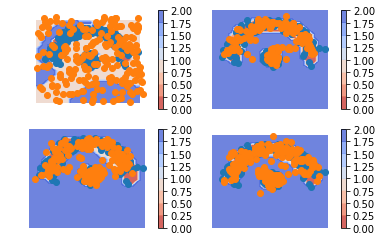

iteration  82
3.0062897 0.02244123 0.7404985 2.24335


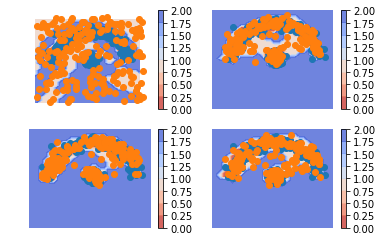

iteration  83
4.0626454 0.023982119 0.7330235 3.3056397


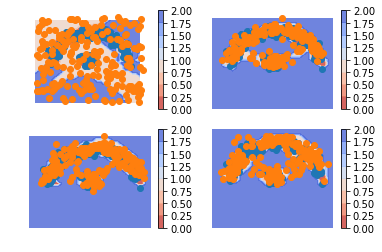

iteration  84
3.9939663 0.023538299 0.7424309 3.227997


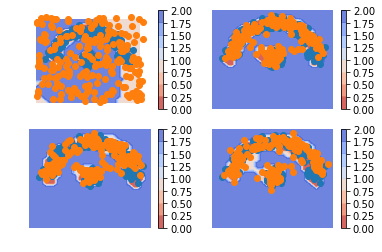

iteration  85
3.5606394 0.023304094 0.73569393 2.8016415


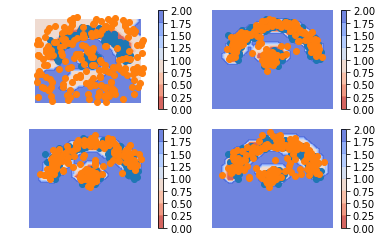

iteration  86
4.951873 0.023311313 0.74247783 4.186084


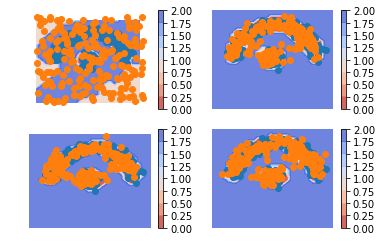

iteration  87
3.942363 0.023010276 0.72745186 3.191901


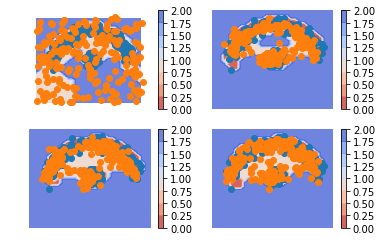

iteration  88
3.6210258 0.023941495 0.74241954 2.8546648


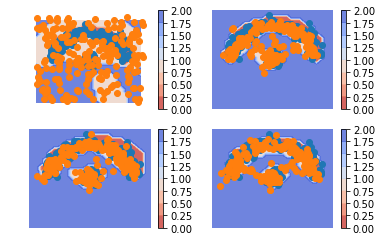

iteration  89
3.4601536 0.025821388 0.6874761 2.746856


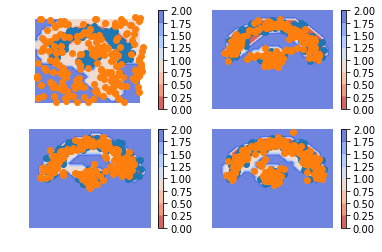

iteration  90
3.7644236 0.028809369 0.75531125 2.980303


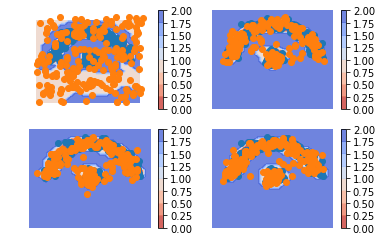

iteration  91
3.606698 0.031008136 0.7710352 2.8046548


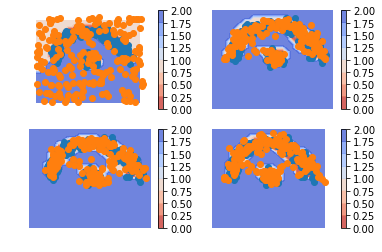

iteration  92
3.3477604 0.034262754 0.79700696 2.5164907


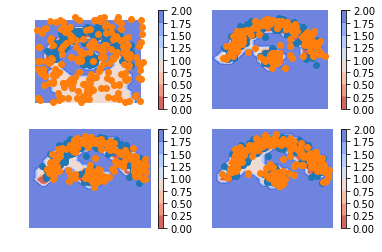

iteration  93
3.2848966 0.03622844 0.7627783 2.48589


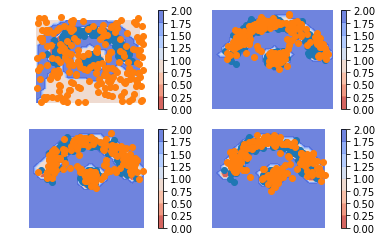

iteration  94
3.0978656 0.037954956 0.6900562 2.3698545


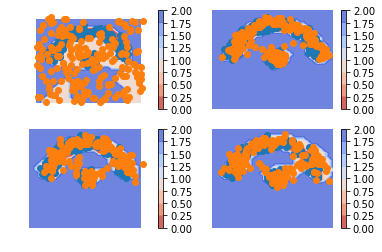

iteration  95
3.7527218 0.039685193 0.74775875 2.965278


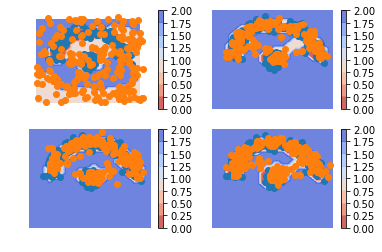

iteration  96
2.8786476 0.04031443 0.76011056 2.0782225


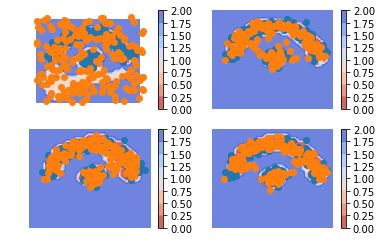

iteration  97
3.3238044 0.04013829 0.73881 2.544856


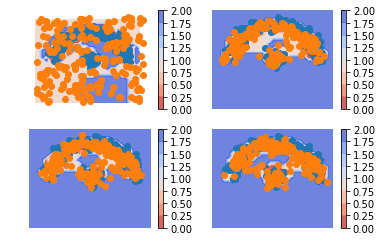

iteration  98
3.471327 0.0386536 0.7275582 2.7051153


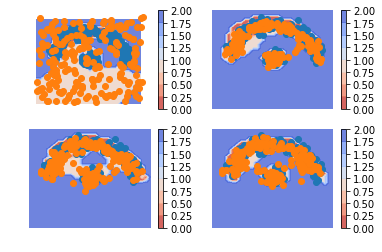

iteration  99
3.8923225 0.037455488 0.7433855 3.1114817


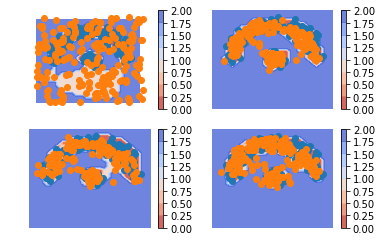

iteration  100
3.3731918 0.036671817 0.703932 2.6325881


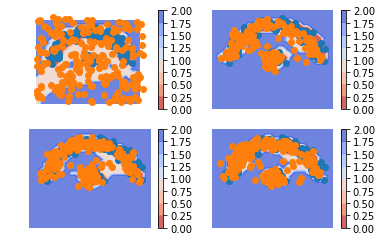

iteration  101
4.1857076 0.034546237 0.6930851 3.4580762


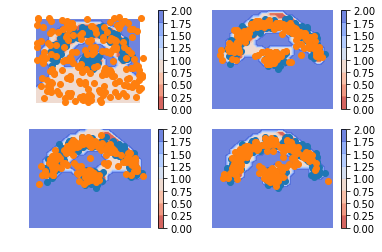

iteration  102
4.4691644 0.030389857 0.8062695 3.6325052


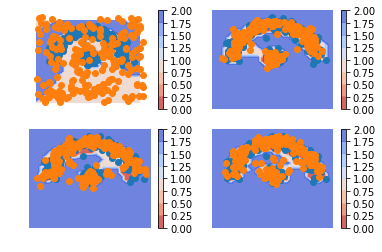

iteration  103
3.582482 0.027256489 0.7627015 2.792524


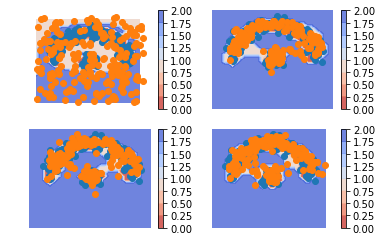

iteration  104
2.5516405 0.024725055 0.7609357 1.7659798


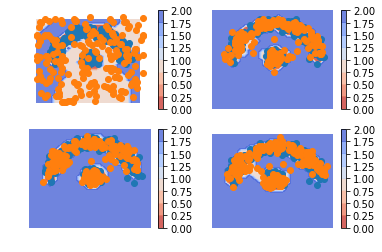

iteration  105
2.289942 0.022543242 0.736243 1.5311557


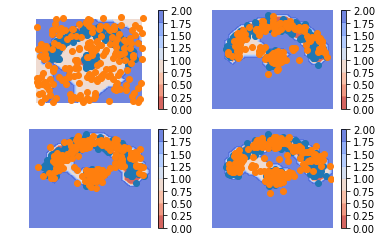

iteration  106
3.488749 0.021558138 0.7226001 2.7445908


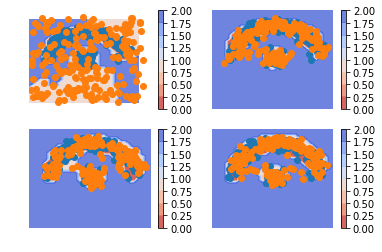

iteration  107
3.7363691 0.020106465 0.71144027 3.0048223


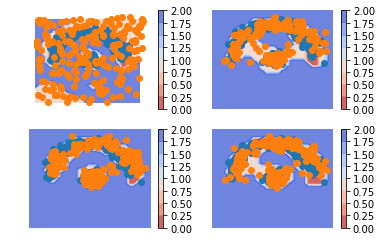

iteration  108
3.5132353 0.01937724 0.75981957 2.7340386


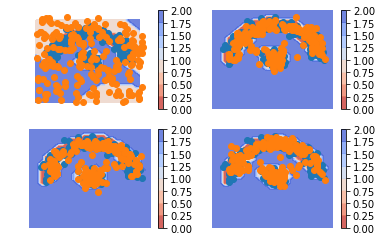

iteration  109
3.6364596 0.019108497 0.7142863 2.9030647


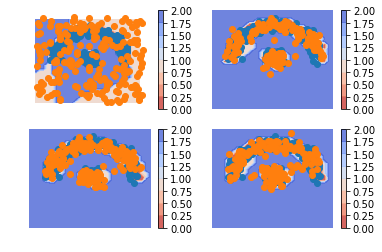

iteration  110
4.1672945 0.018874472 0.7270412 3.4213786


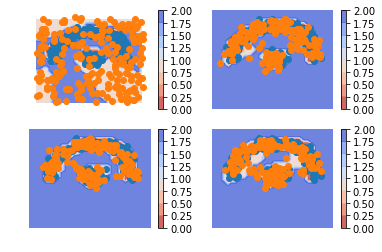

iteration  111
3.7249634 0.017624423 0.7479572 2.9593818


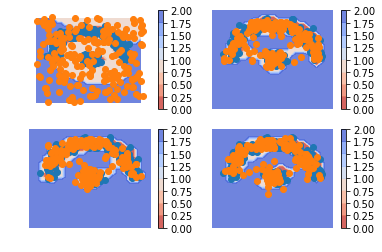

iteration  112
4.1997895 0.017201046 0.7304566 3.4521317


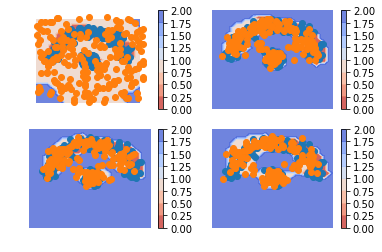

iteration  113
4.080733 0.01686141 0.73236287 3.3315084


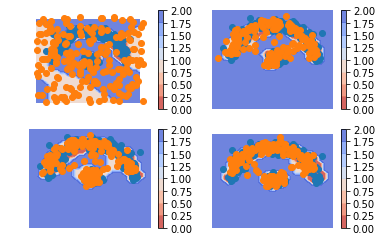

iteration  114
4.0330563 0.015526004 0.70663655 3.3108935


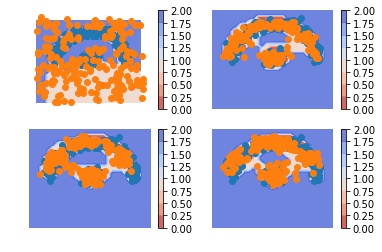

iteration  115
3.550837 0.015806595 0.745717 2.7893133


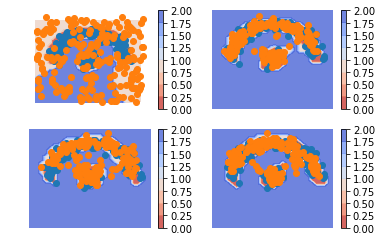

iteration  116
3.1771724 0.014731693 0.7516986 2.410742


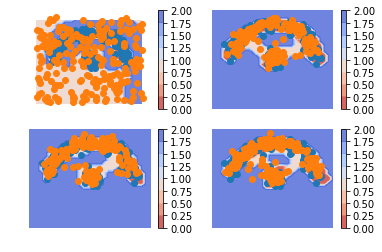

iteration  117
2.954752 0.0146105625 0.718198 2.2219434


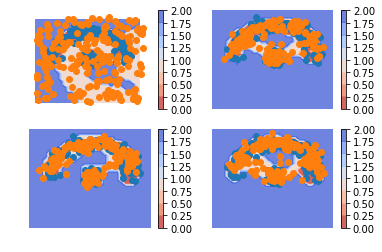

iteration  118
2.9284427 0.014268173 0.7113891 2.2027855


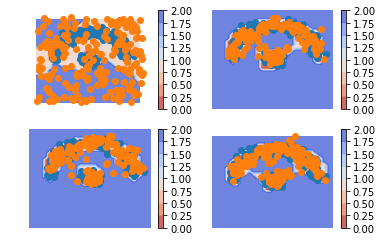

iteration  119
2.6980343 0.013626448 0.71730447 1.9671035


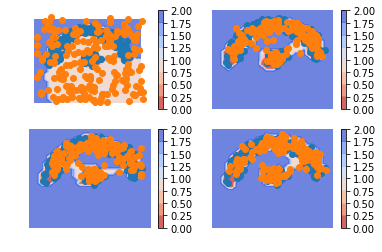

iteration  120
2.756486 0.012652651 0.778801 1.9650323


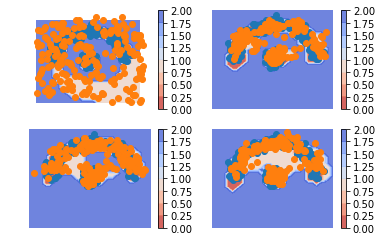

iteration  121
3.0016773 0.012152886 0.7266881 2.2628362


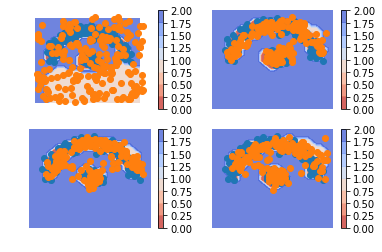

iteration  122
4.408604 0.01103595 0.7489481 3.6486201


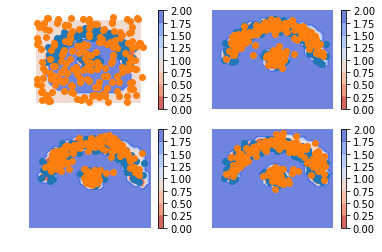

iteration  123
4.5223475 0.010340249 0.73088956 3.7811177


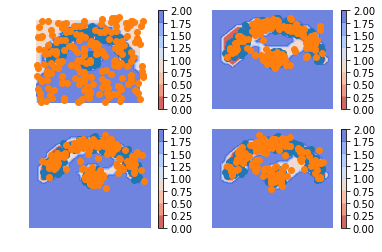

iteration  124
5.1637673 0.009803454 0.7234626 4.4305015


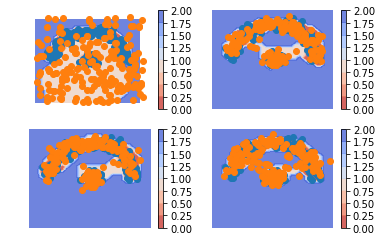

iteration  125
5.103535 0.008976643 0.69497144 4.399587


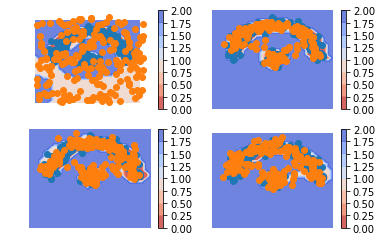

iteration  126
5.492046 0.009144092 0.7112065 4.771695


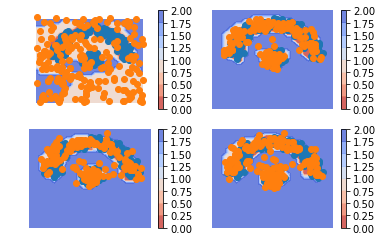

iteration  127
5.975941 0.009152755 0.71570915 5.251079


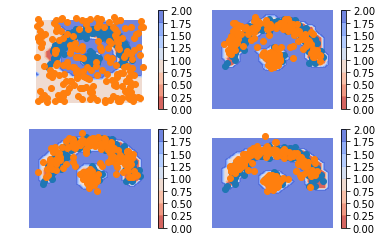

iteration  128
3.845773 0.010188992 0.7377987 3.0977852


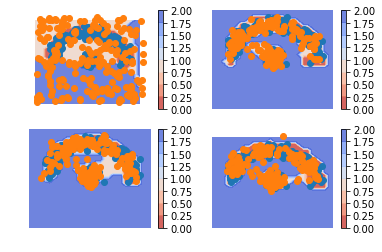

iteration  129
2.6714487 0.011305768 0.7676972 1.8924457


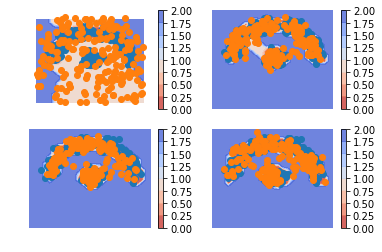

iteration  130
2.7357833 0.012696268 0.73264974 1.9904374


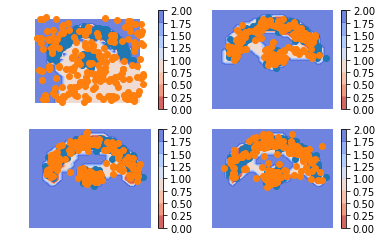

iteration  131
3.728303 0.0145413065 0.74846303 2.9652987


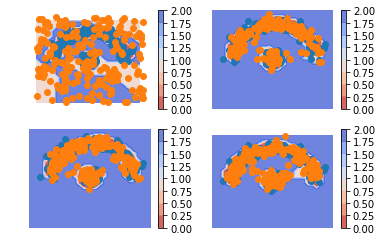

iteration  132
4.738637 0.016250052 0.7407809 3.981606


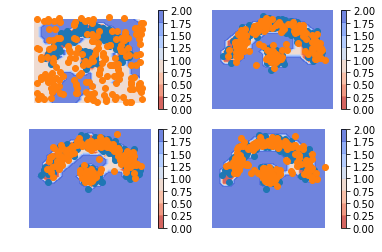

iteration  133
4.130897 0.018328672 0.72423804 3.3883302


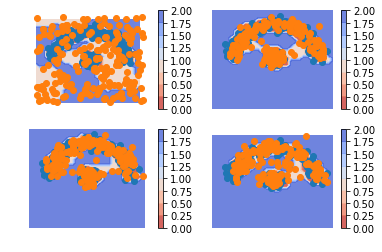

iteration  134
3.58702 0.019456562 0.7197468 2.8478165


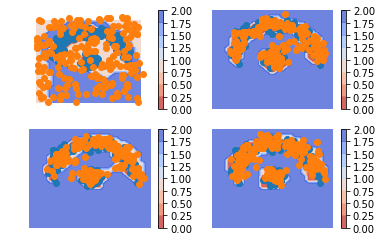

iteration  135
3.756743 0.01931032 0.72021466 3.017218


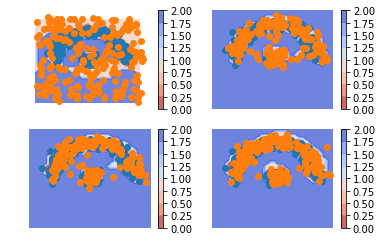

iteration  136
3.0882292 0.01954803 0.7451401 2.323541


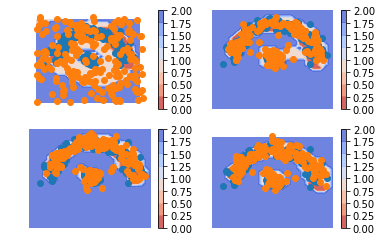

iteration  137
2.9300075 0.018752325 0.7258612 2.185394


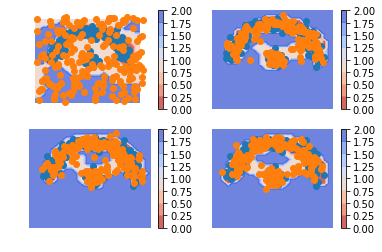

iteration  138
3.6801918 0.016994556 0.7240732 2.939124


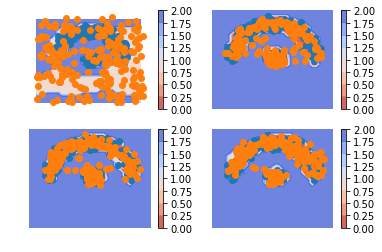

iteration  139
4.4129376 0.016034603 0.75028414 3.646619


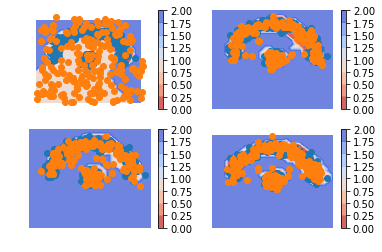

iteration  140
3.927835 0.016431741 0.6982758 3.2131274


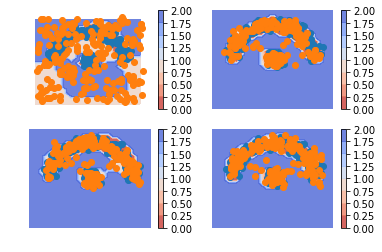

iteration  141
4.004427 0.016693026 0.7231931 3.2645407


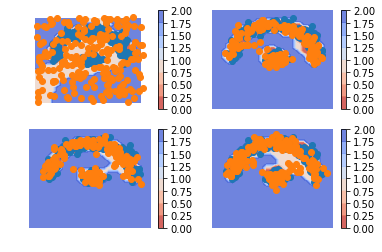

iteration  142
4.8351455 0.016979255 0.735896 4.08227


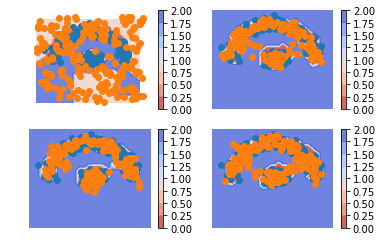

iteration  143
4.7630386 0.017664606 0.7171822 4.028192


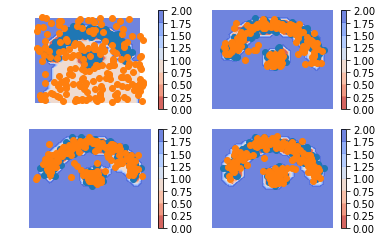

iteration  144
3.8646054 0.018089175 0.6967014 3.1498148


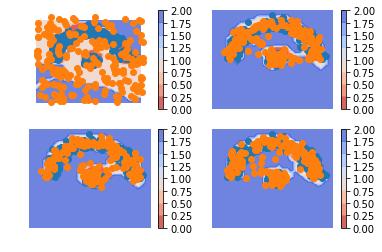

iteration  145
3.666833 0.018331282 0.73740184 2.9110997


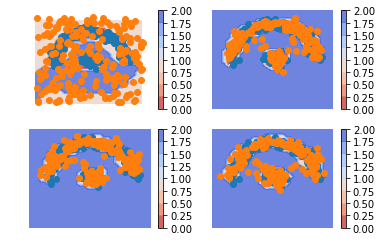

iteration  146
2.97457 0.018991983 0.77898735 2.1765907


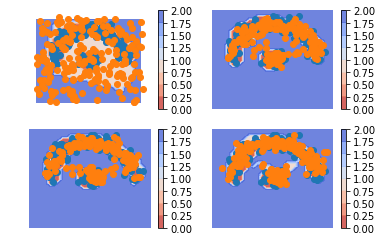

iteration  147
2.8661463 0.019688286 0.70858717 2.1378708


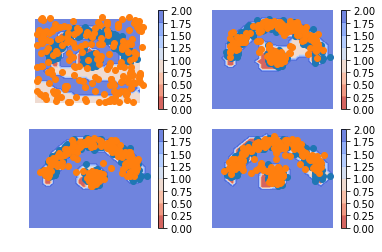

iteration  148
2.4204586 0.017576318 0.7401206 1.6627617


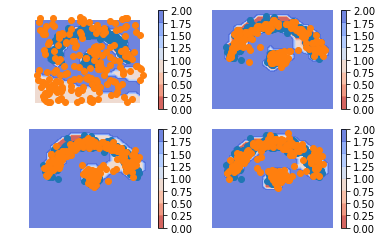

iteration  149
2.7132254 0.020342333 0.74781275 1.9450701


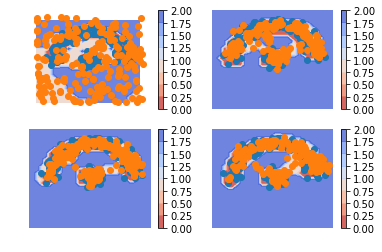

iteration  150
4.005667 0.02089559 0.7451704 3.2396011


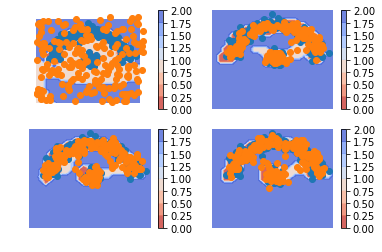

iteration  151
4.1446667 0.020855682 0.70514095 3.4186702


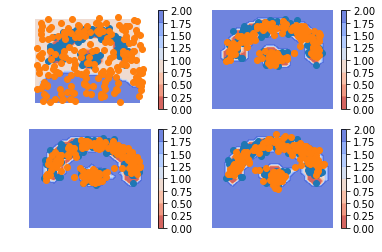

iteration  152
3.3288732 0.018511191 0.7142164 2.5961456


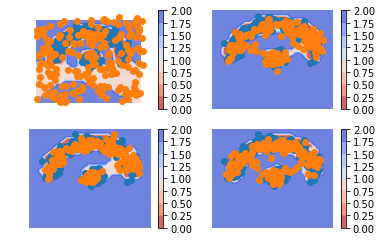

iteration  153
3.5972784 0.01671677 0.6809819 2.8995798


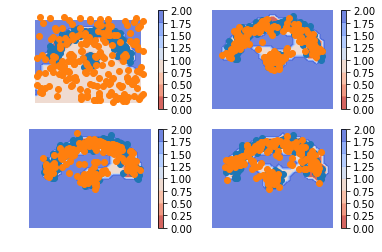

iteration  154
4.262436 0.015513382 0.7310165 3.5159059


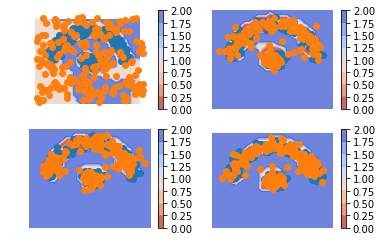

iteration  155
4.8438034 0.015308142 0.71782523 4.11067


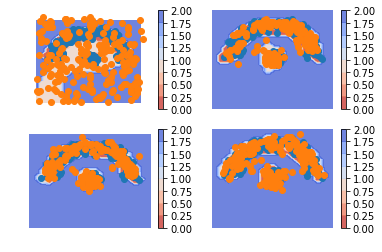

iteration  156
4.814422 0.014921821 0.7174233 4.082077


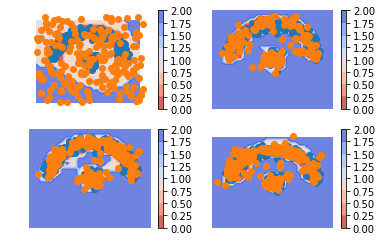

iteration  157
3.5362988 0.013535542 0.7106105 2.8121526


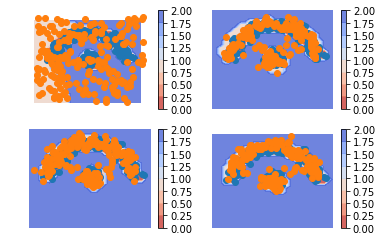

iteration  158
3.4896111 0.012364926 0.7075721 2.769674


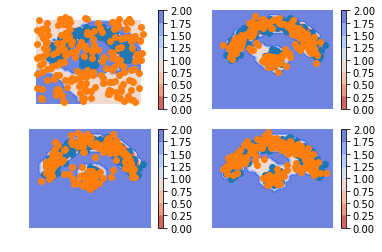

iteration  159
3.8098986 0.012664792 0.7126934 3.0845404


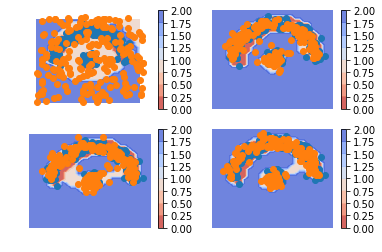

iteration  160
4.1614623 0.012941823 0.7586668 3.3898537


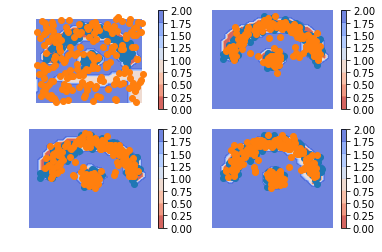

iteration  161
3.1323662 0.012627382 0.7604102 2.3593287


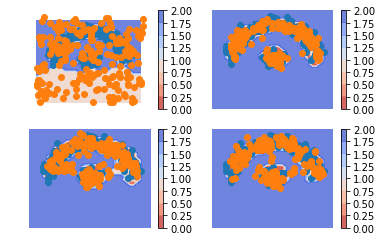

iteration  162
4.348481 0.0132636065 0.74172986 3.593488


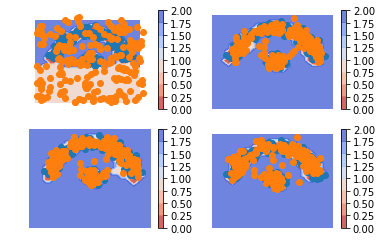

iteration  163
5.0706663 0.012641638 0.72901523 4.3290095


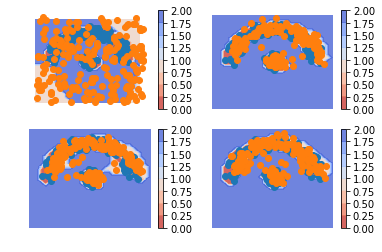

iteration  164
3.9607902 0.0129866935 0.7312303 3.216573


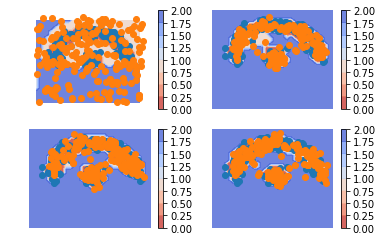

iteration  165
4.537409 0.012869737 0.6945766 3.8299625


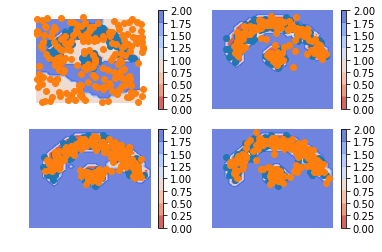

iteration  166
3.9020782 0.013295588 0.7009758 3.1878068


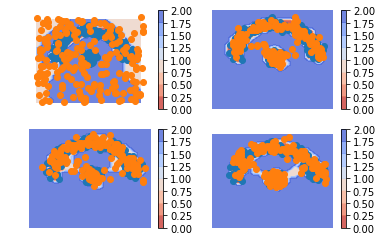

iteration  167
4.365208 0.013054151 0.70915604 3.642998


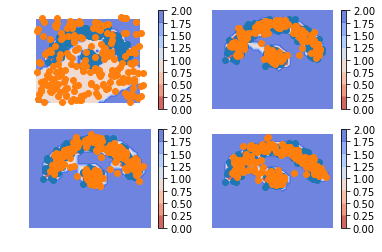

iteration  168
4.0951896 0.013870489 0.70880777 3.3725111


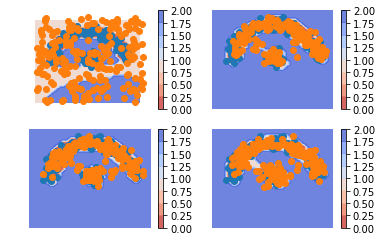

iteration  169
4.48026 0.01330233 0.71588266 3.751075


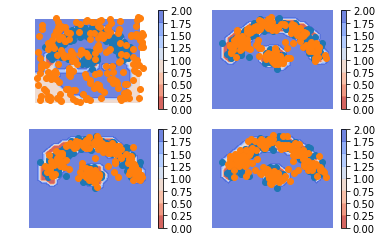

iteration  170
3.9148724 0.012364087 0.76060796 3.1419003


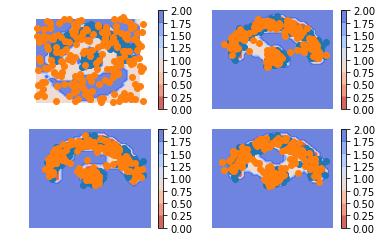

iteration  171
4.3994102 0.012337516 0.7190727 3.668


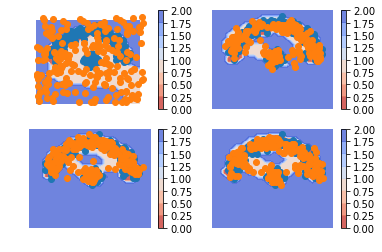

iteration  172
3.9745266 0.01161063 0.75334007 3.209576


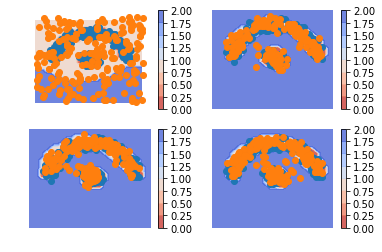

iteration  173
4.598661 0.012243793 0.7227012 3.8637161


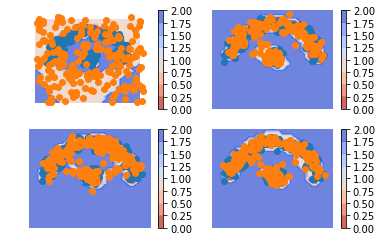

iteration  174
4.4194665 0.013116715 0.71679366 3.6895561


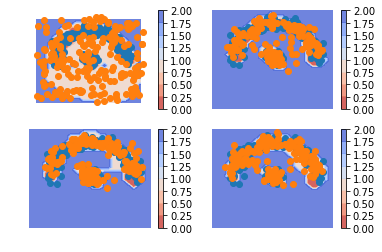

iteration  175
3.970685 0.01307115 0.75962967 3.1979842


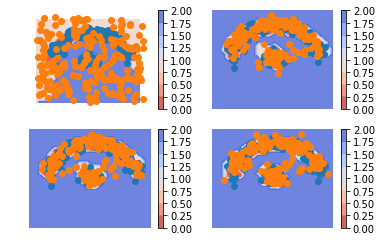

iteration  176
3.9060988 0.014255881 0.70680386 3.185039


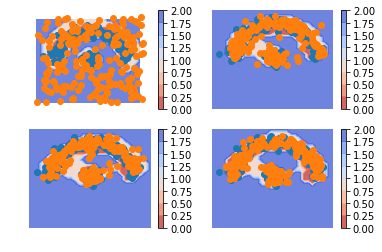

iteration  177
4.291382 0.014488272 0.79603887 3.4808545


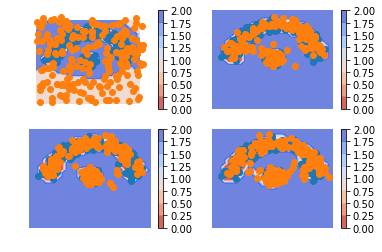

iteration  178
3.258638 0.015102288 0.73745036 2.5060852


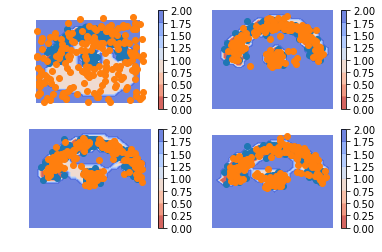

iteration  179
3.8715305 0.01606168 0.71542835 3.1400404


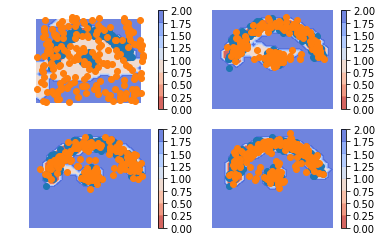

iteration  180
3.6383762 0.016946688 0.702393 2.9190366


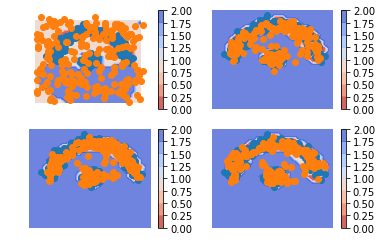

iteration  181
3.778522 0.017978106 0.6854779 3.0750659


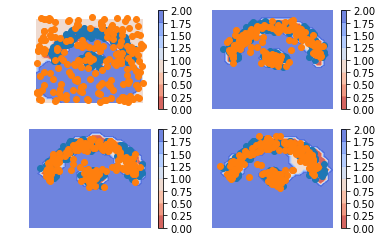

iteration  182
4.0755177 0.018466467 0.74575615 3.3112953


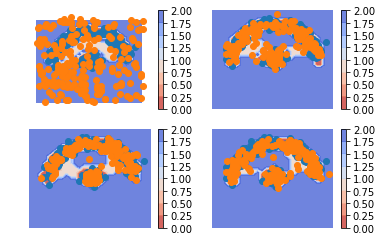

iteration  183
3.4960265 0.01960902 0.7364693 2.7399483


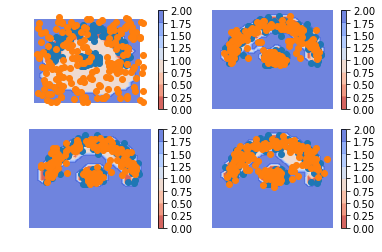

iteration  184
3.305386 0.021053437 0.76497227 2.5193603


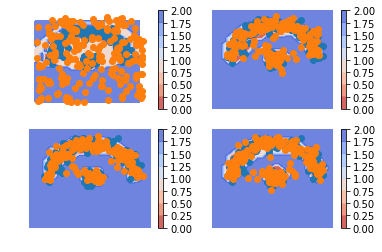

iteration  185
3.6744447 0.021382816 0.74404395 2.9090178


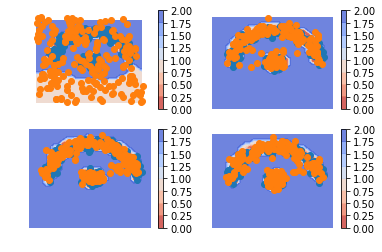

iteration  186
3.835371 0.021989321 0.7305281 3.0828536


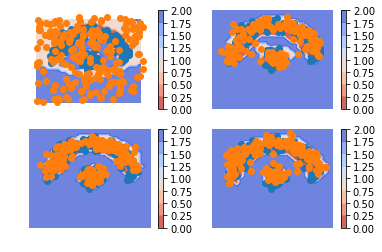

iteration  187
3.7804556 0.022714881 0.69754183 3.0601988


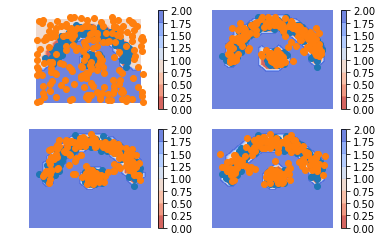

iteration  188
3.7975914 0.022941513 0.73807317 3.0365767


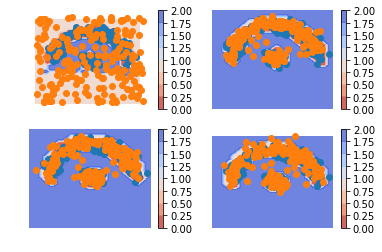

iteration  189
3.4375565 0.02286161 0.78843814 2.6262567


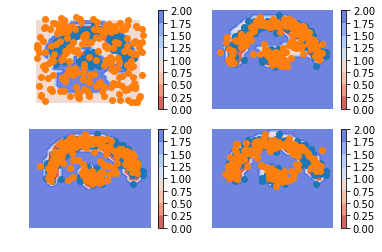

iteration  190
4.913306 0.023272796 0.7441416 4.1458917


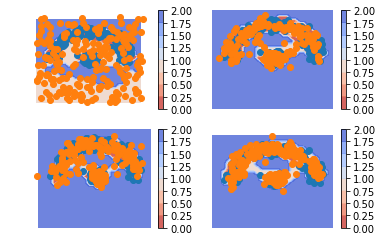

iteration  191
4.758843 0.023176234 0.73086524 4.0048013


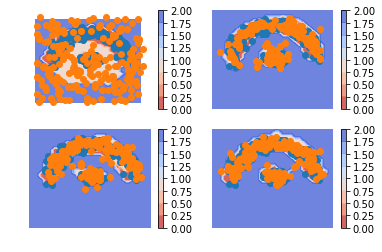

iteration  192
3.3521833 0.023306984 0.73557794 2.5932984


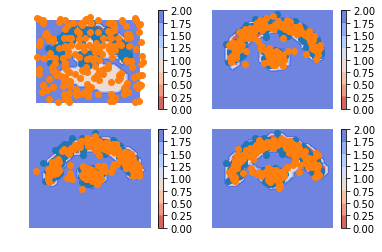

iteration  193
4.318867 0.02302145 0.71840364 3.5774422


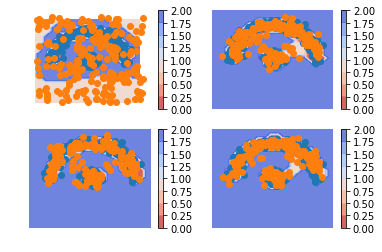

iteration  194
3.237775 0.022836976 0.6923268 2.5226114


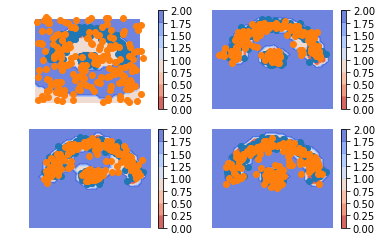

iteration  195
3.8334095 0.022578906 0.71504456 3.095786


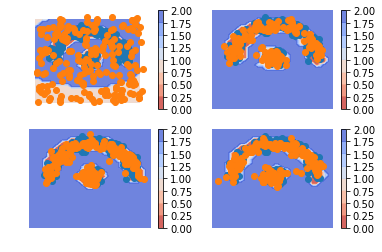

iteration  196
3.8858726 0.022613028 0.69939613 3.1638634


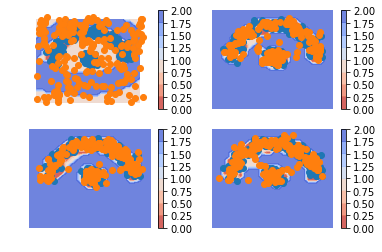

iteration  197
3.545704 0.023135917 0.762408 2.76016


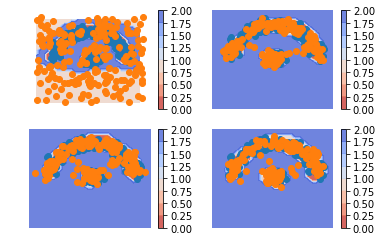

iteration  198
3.5188136 0.022206593 0.7234333 2.7731738


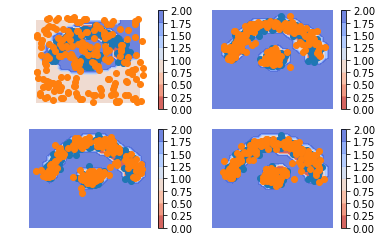

iteration  199
3.9185865 0.020846806 0.7131491 3.1845906


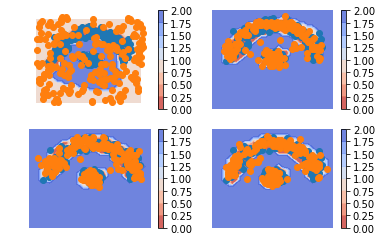

iteration  200
4.2123833 0.019926291 0.74547267 3.446984


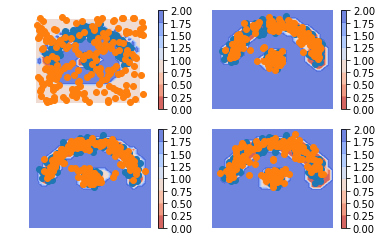

iteration  201
2.7878175 0.019481821 0.70700526 2.0613303


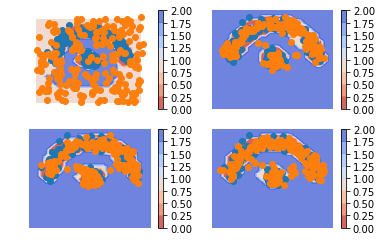

iteration  202
2.8569238 0.018964143 0.6986663 2.1392934


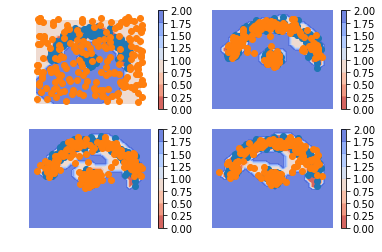

iteration  203
3.2877548 0.018708138 0.73515946 2.5338871


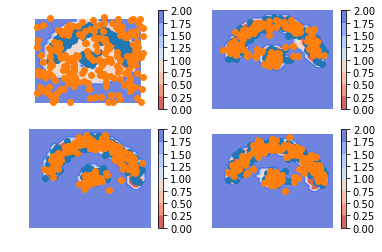

iteration  204
3.369056 0.018236665 0.73535085 2.6154685


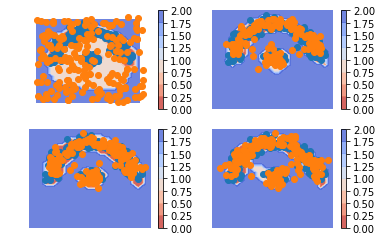

iteration  205
3.3389986 0.01734604 0.7457713 2.5758812


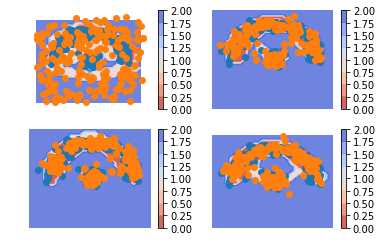

iteration  206
3.4818547 0.016812662 0.7237138 2.7413282


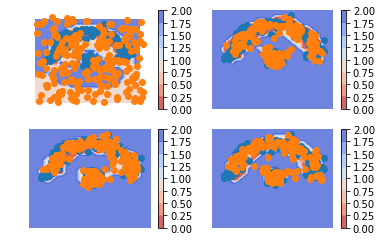

iteration  207
3.780684 0.015567377 0.7340573 3.0310593


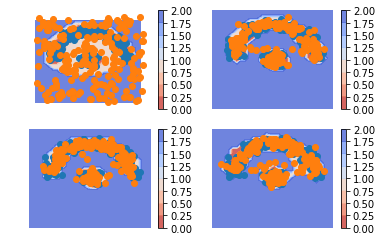

iteration  208
4.4277964 0.014354605 0.68746936 3.7259722


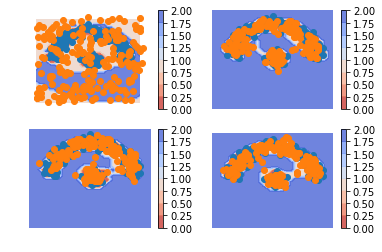

iteration  209
4.778921 0.013473 0.7175429 4.0479054


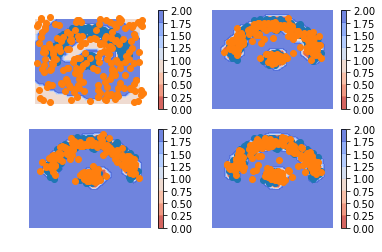

iteration  210
5.5710397 0.0133460695 0.69606256 4.861631


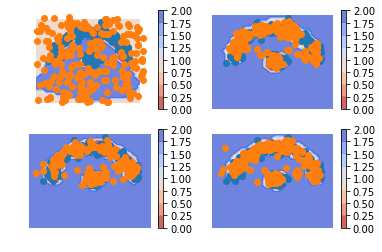

iteration  211
5.1859713 0.013942151 0.7030031 4.469026


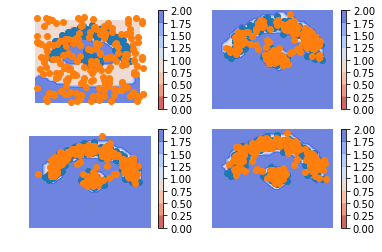

iteration  212
5.289833 0.01369811 0.70731026 4.568825


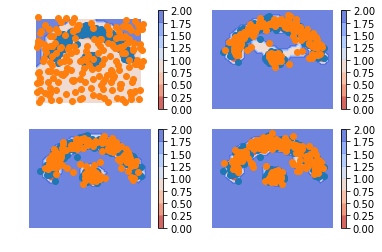

iteration  213
5.1005893 0.013194878 0.7001149 4.3872795


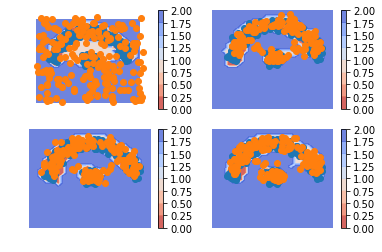

iteration  214
4.8887286 0.013001838 0.74540436 4.1303225


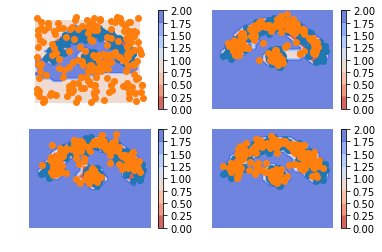

iteration  215
4.745968 0.012728864 0.74067235 3.9925668


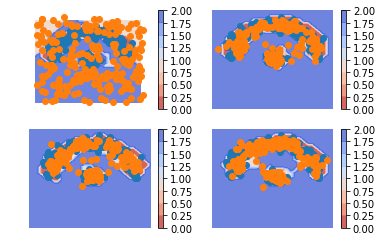

iteration  216
5.5791388 0.013085236 0.7395891 4.826464


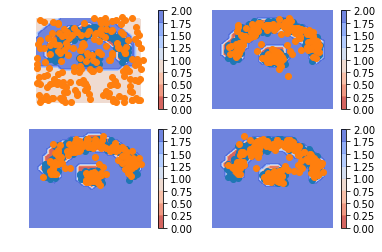

iteration  217
5.2338543 0.011666307 0.70791066 4.5142775


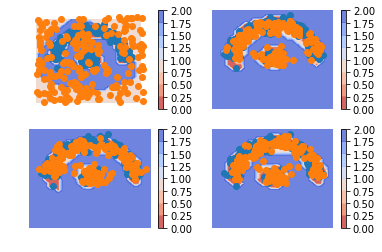

iteration  218
3.3555672 0.011141401 0.72876203 2.6156638


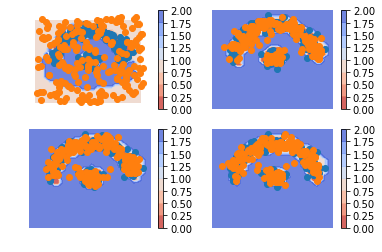

iteration  219
2.8570497 0.010265857 0.7381897 2.1085942


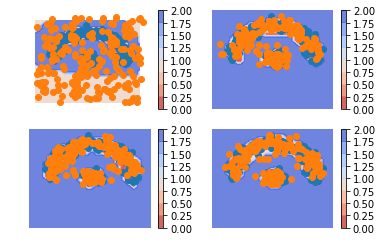

iteration  220
3.4993575 0.010194145 0.73893356 2.7502298


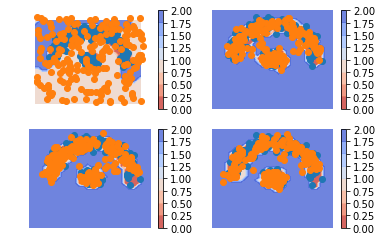

iteration  221
3.980011 0.010728499 0.6891403 3.2801423


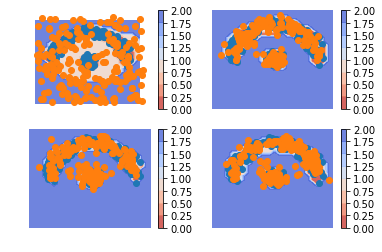

iteration  222
3.2791352 0.011481247 0.6936822 2.5739717


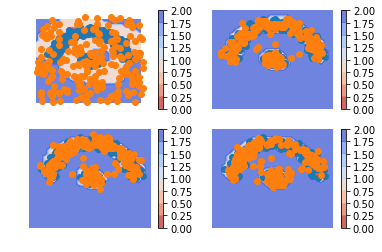

iteration  223
4.9065 0.012607046 0.72467107 4.169222


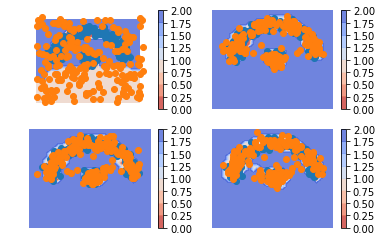

iteration  224
5.0662775 0.013106481 0.7424729 4.310698


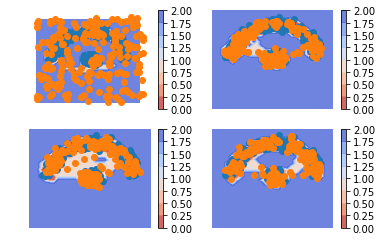

iteration  225
5.2390084 0.013330954 0.78792876 4.437749


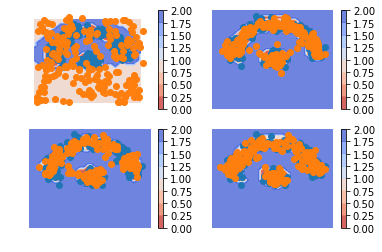

iteration  226
4.2204647 0.012885481 0.7028534 3.5047257


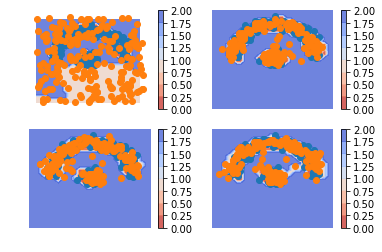

iteration  227
4.9607105 0.011877792 0.7216822 4.2271504


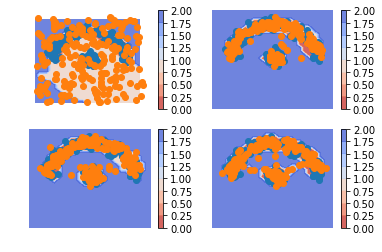

iteration  228
4.4746957 0.011189367 0.7624049 3.7011015


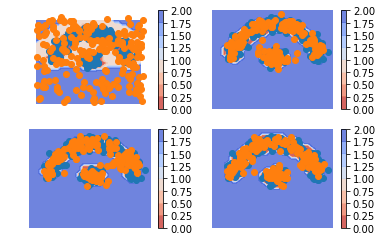

iteration  229
3.9987414 0.01110745 0.7362802 3.2513537


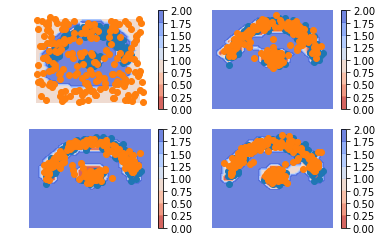

iteration  230
4.142365 0.011436283 0.7386123 3.3923163


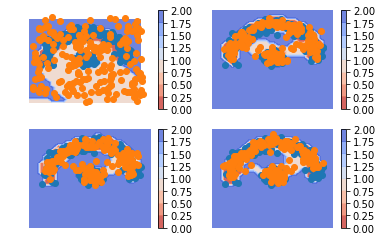

iteration  231
3.6480463 0.011519279 0.7697041 2.866823


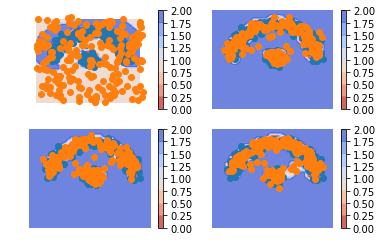

iteration  232
4.1909385 0.012138673 0.71889585 3.459904


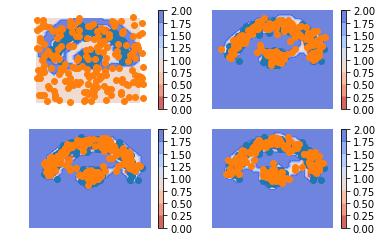

iteration  233
3.890762 0.013265979 0.719535 3.1579611


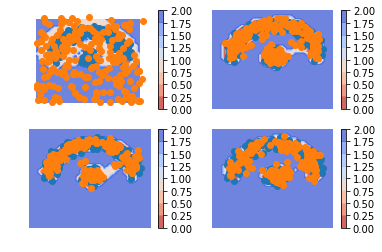

iteration  234
3.7484908 0.014498702 0.71310353 3.0208886


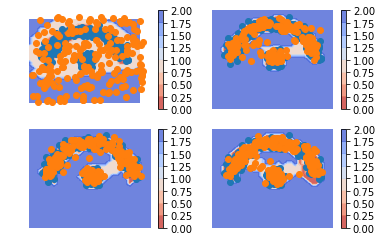

iteration  235
3.6516948 0.016473264 0.7379736 2.897248


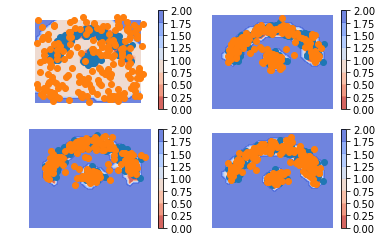

iteration  236
3.619709 0.018007433 0.7252838 2.8764179


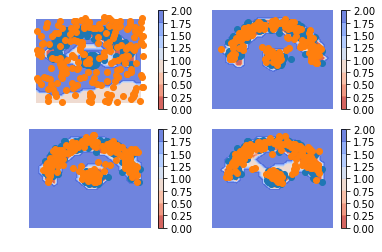

iteration  237
3.604295 0.019408798 0.7483099 2.8365762


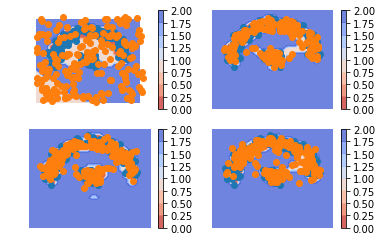

iteration  238
3.65041 0.020361876 0.732006 2.898042


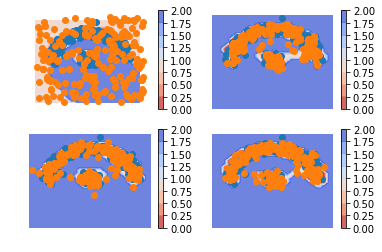

iteration  239
3.94292 0.020785687 0.7701909 3.1519434


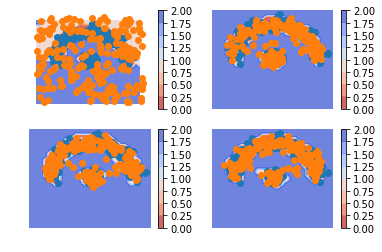

iteration  240
2.749161 0.021278875 0.76182836 1.9660538


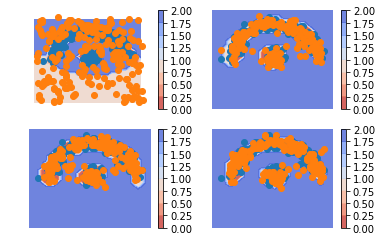

iteration  241
2.7527916 0.02168123 0.741235 1.9898753


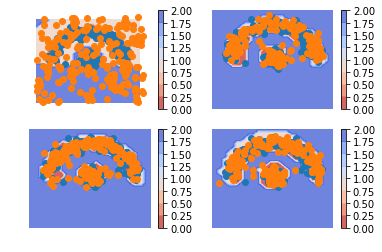

iteration  242
2.690939 0.021381622 0.7353635 1.934194


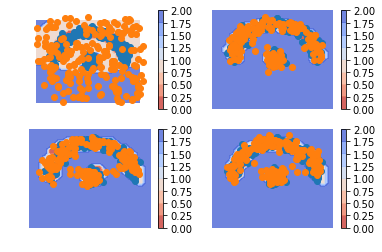

iteration  243
3.620397 0.021343553 0.7438042 2.8552494


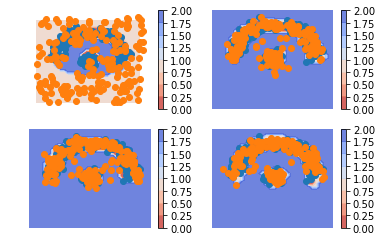

iteration  244
4.187247 0.02100116 0.73194593 3.4342997


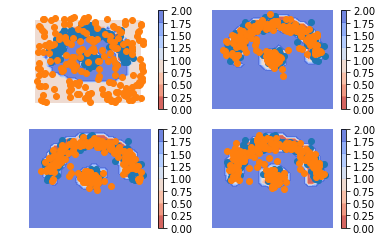

iteration  245
2.9756844 0.02069062 0.75319296 2.2018008


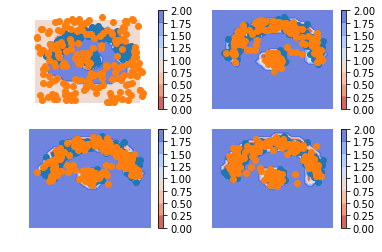

iteration  246
3.4705343 0.020630576 0.69915015 2.7507536


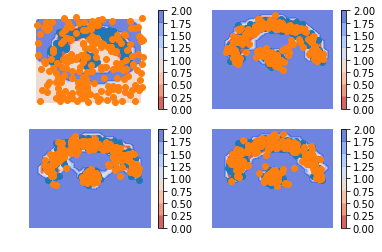

iteration  247
3.5411308 0.020199027 0.7435559 2.777376


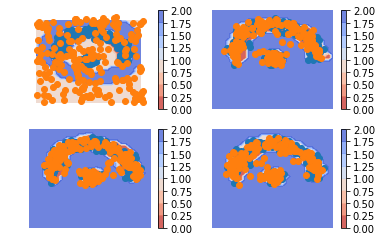

iteration  248
2.937522 0.019839726 0.7658422 2.15184


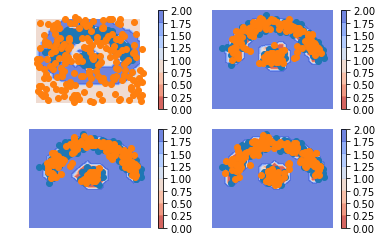

iteration  249
2.6618764 0.018959638 0.749469 1.8934479


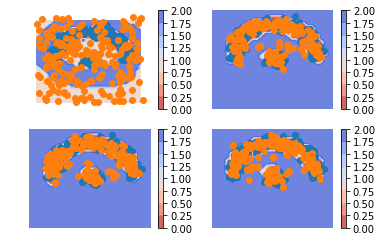

iteration  250
2.9345357 0.018094983 0.7231935 2.1932473


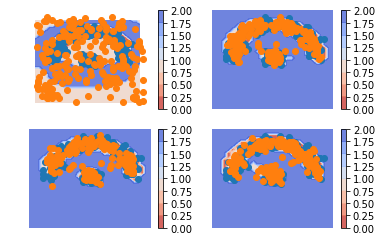

iteration  251
3.1015916 0.017683372 0.69921577 2.3846924


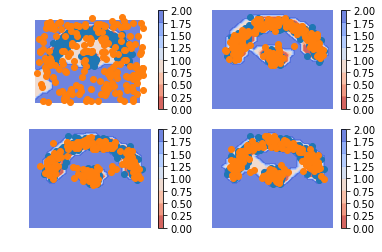

iteration  252
3.3156924 0.017393453 0.7167716 2.5815275


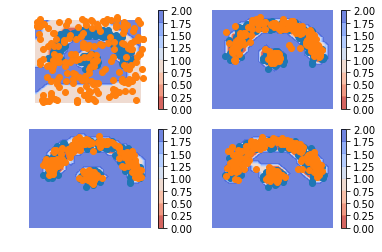

iteration  253
3.4889972 0.01721071 0.6881485 2.783638


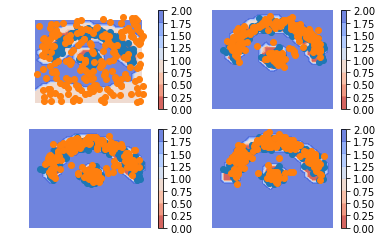

iteration  254
3.7217772 0.017244207 0.73318374 2.9713492


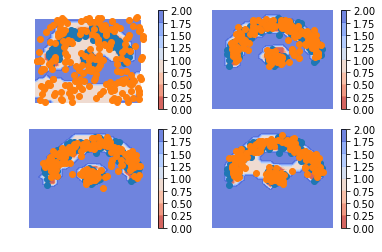

iteration  255
2.7866528 0.016935294 0.6980353 2.0716822


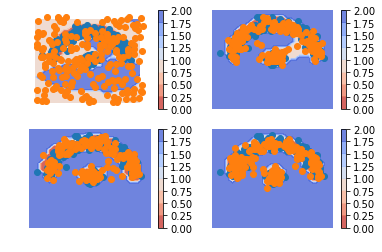

iteration  256
3.2972963 0.016686227 0.7156674 2.5649426


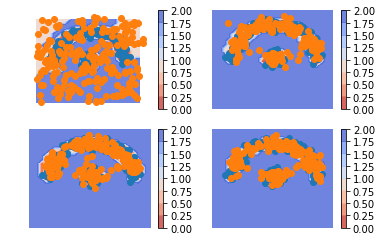

iteration  257
3.3070729 0.016052283 0.7279172 2.5631034


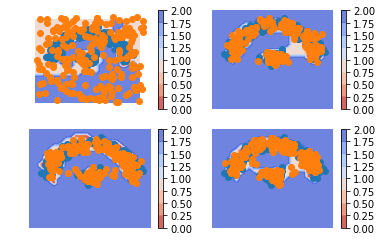

iteration  258
3.8776386 0.015668495 0.77139646 3.0905735


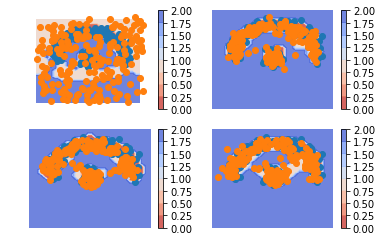

iteration  259
4.3809233 0.015092262 0.7362645 3.6295667


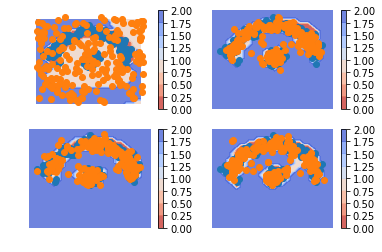

iteration  260
3.1436415 0.014327556 0.7273375 2.4019763


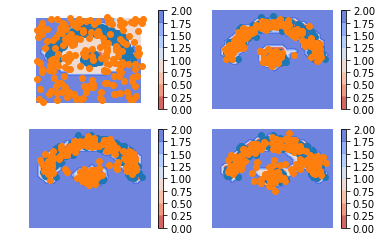

iteration  261
4.6796274 0.013615532 0.71867657 3.9473352


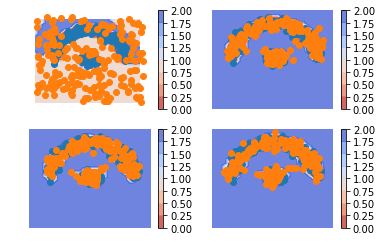

iteration  262
4.1943517 0.01281764 0.76374185 3.417792


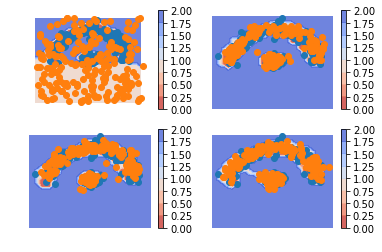

iteration  263
3.2914555 0.012158685 0.7637044 2.5155923


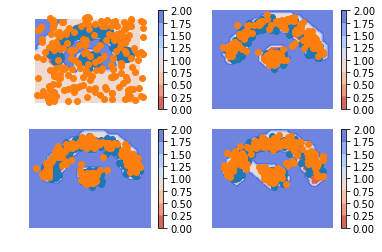

iteration  264
2.6733696 0.011632727 0.74306047 1.9186764


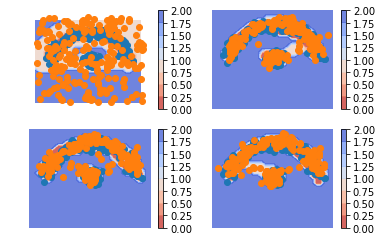

iteration  265
3.404101 0.011413203 0.73791254 2.6547751


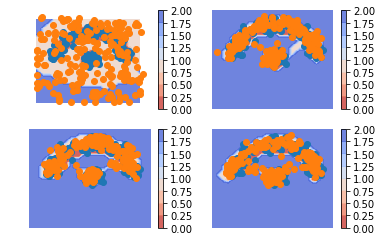

iteration  266
4.0015736 0.010879294 0.7485702 3.2421243


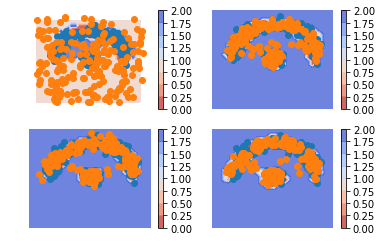

iteration  267
3.2826707 0.010641282 0.7061547 2.5658748


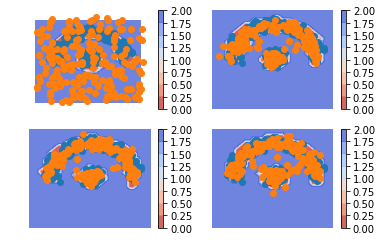

iteration  268
2.7180464 0.0104096625 0.72735107 1.9802856


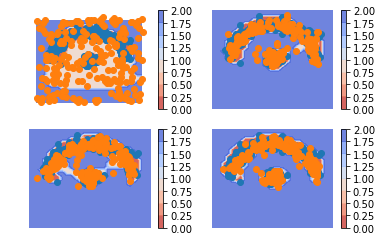

iteration  269
3.6919887 0.010412055 0.7053163 2.9762604


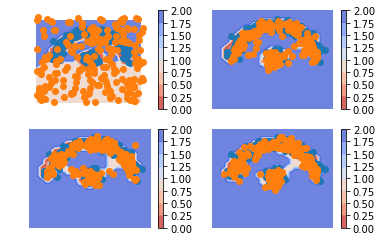

iteration  270
3.3586376 0.010392425 0.7262144 2.6220307


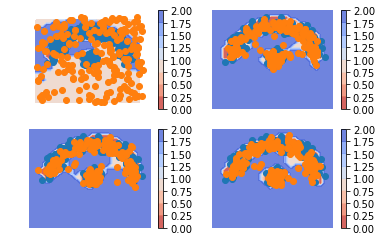

iteration  271
2.9716148 0.010251907 0.7279727 2.2333903


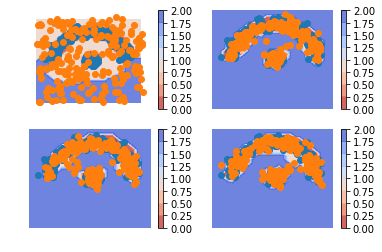

iteration  272
2.7987423 0.010643557 0.7134631 2.0746357


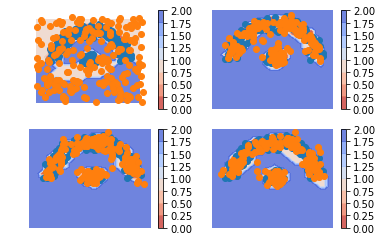

iteration  273
3.3084793 0.010829301 0.73446697 2.563183


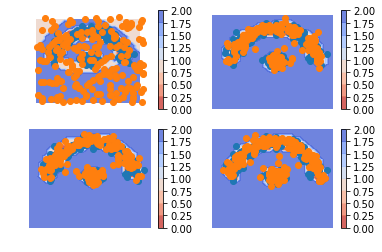

iteration  274
3.0269048 0.011122429 0.7452396 2.2705429


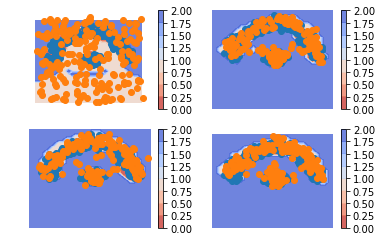

iteration  275
3.1689396 0.011739312 0.7590905 2.3981097


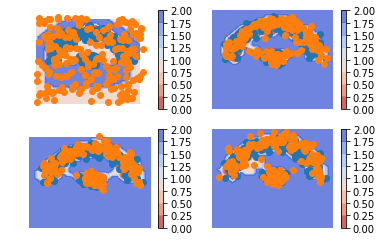

iteration  276
3.6265764 0.012598777 0.71325076 2.900727


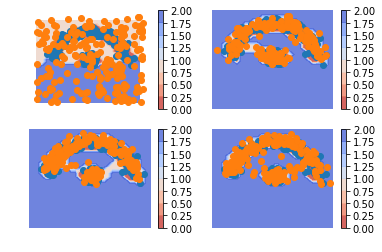

iteration  277
3.9945517 0.013300716 0.722508 3.2587428


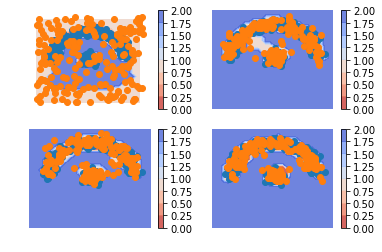

iteration  278
3.3849833 0.014804039 0.7264316 2.6437476


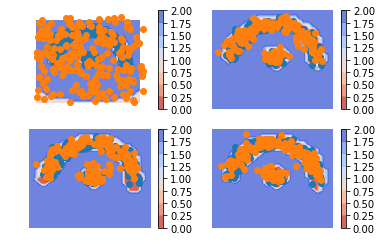

iteration  279
2.5256362 0.016505351 0.73463476 1.7744961


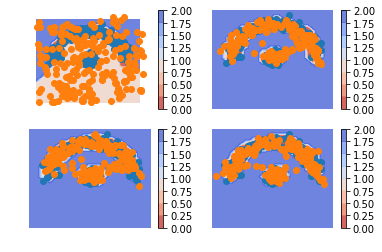

iteration  280
2.7480834 0.017373502 0.7090256 2.0216842


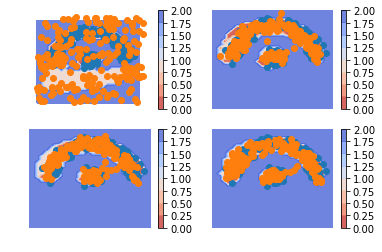

iteration  281
3.6138475 0.01796113 0.6984331 2.8974533


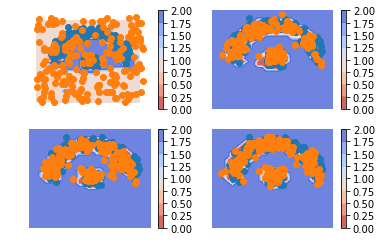

iteration  282
3.1303263 0.018866329 0.7540921 2.357368


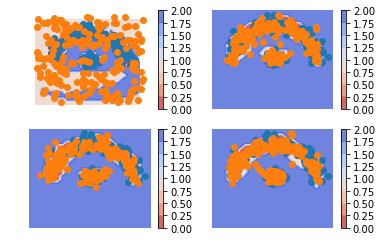

iteration  283
3.5737567 0.019674774 0.7123778 2.8417041


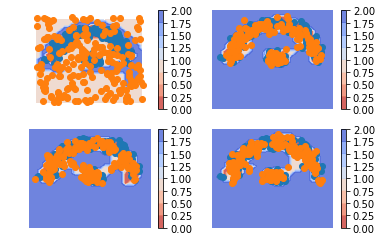

iteration  284
3.1234744 0.019729229 0.76511735 2.3386278


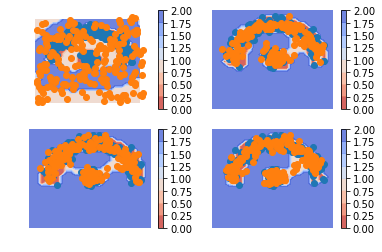

iteration  285
2.310135 0.019520102 0.75464684 1.5359678


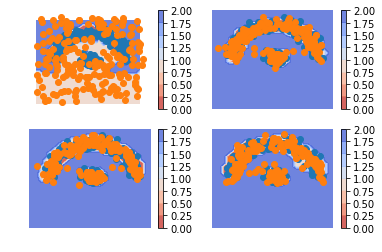

iteration  286
3.1799996 0.019102307 0.78258467 2.3783126


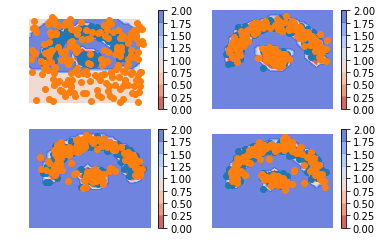

iteration  287
3.215351 0.0187441 0.7054477 2.4911592


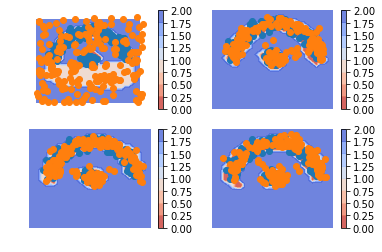

iteration  288
3.8188367 0.0177935 0.7093118 3.0917313


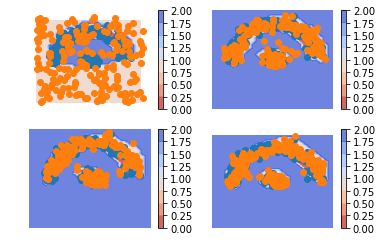

iteration  289
3.9181662 0.017140739 0.7102001 3.1908255


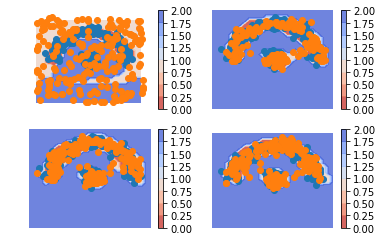

iteration  290
2.7413726 0.016634155 0.7231906 2.0015478


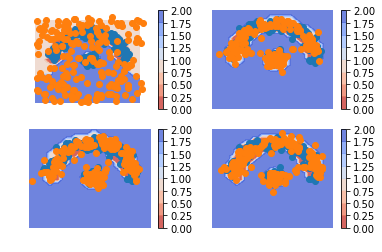

iteration  291
2.9795637 0.015670894 0.72911716 2.2347755


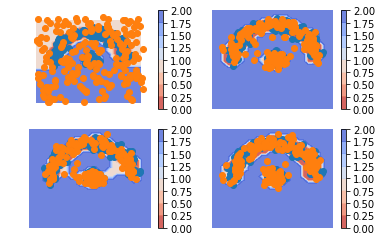

iteration  292
3.6441345 0.015524098 0.7567513 2.871859


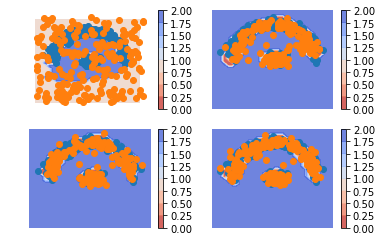

iteration  293
3.9824429 0.015379692 0.76760596 3.1994572


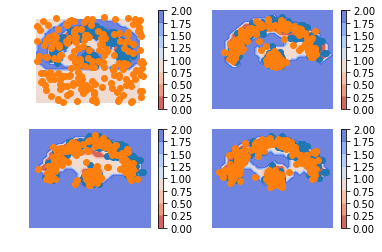

iteration  294
3.7518086 0.015056086 0.7234782 3.0132744


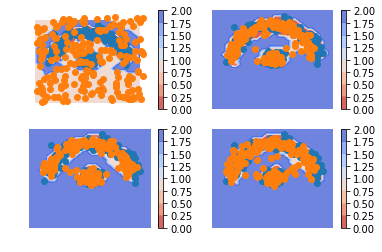

iteration  295
3.227812 0.01497091 0.71256864 2.5002725


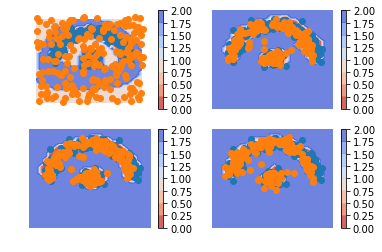

iteration  296
3.301899 0.014947046 0.67676187 2.61019


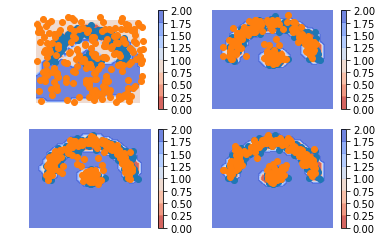

iteration  297
3.3400612 0.014684121 0.70427597 2.6211011


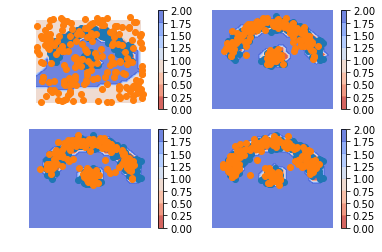

iteration  298
3.4420683 0.013883559 0.72671896 2.7014658


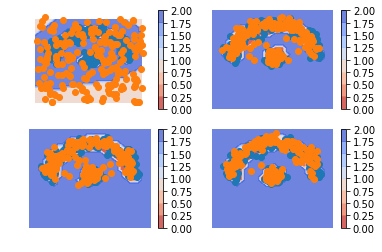

iteration  299
3.412716 0.012846432 0.7373457 2.6625237


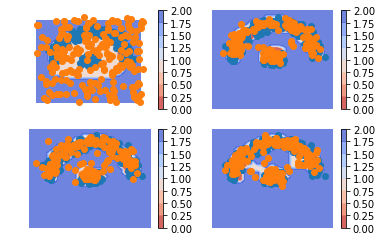

iteration  300
3.5774002 0.011962394 0.71236837 2.8530695


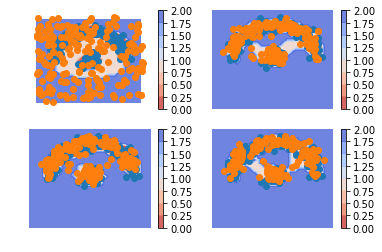

iteration  301
4.399562 0.010945286 0.7286747 3.6599422


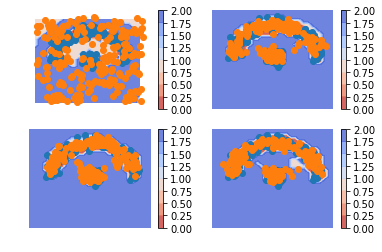

iteration  302
4.64613 0.010006483 0.7270063 3.9091175


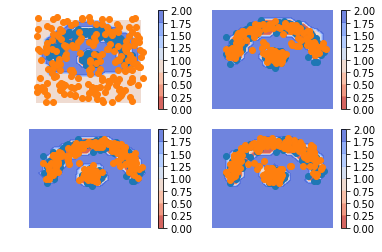

iteration  303
3.5800645 0.010053913 0.69687676 2.873134


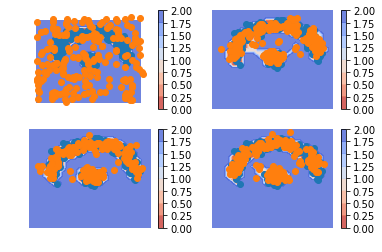

iteration  304
3.9770033 0.010395113 0.7056768 3.2609315


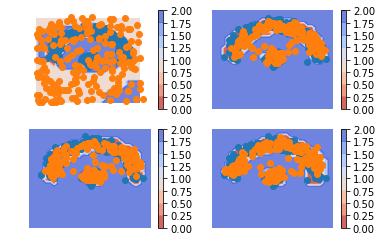

iteration  305
3.7296302 0.010828056 0.7840216 2.9347806


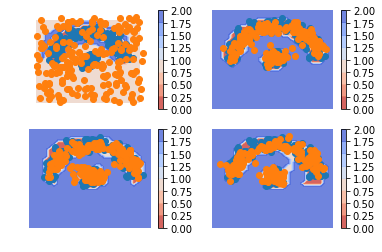

iteration  306
3.9569194 0.011244544 0.71794295 3.227732


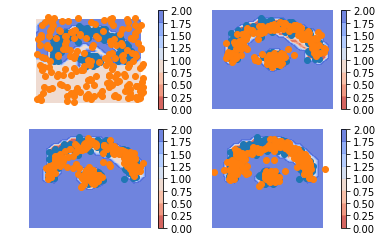

iteration  307
4.375743 0.011712706 0.71610284 3.6479273


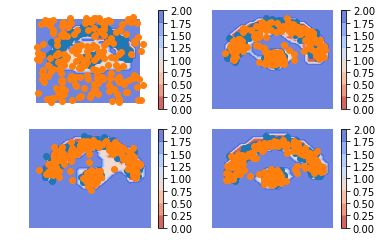

iteration  308
4.477126 0.011743753 0.72923785 3.7361443


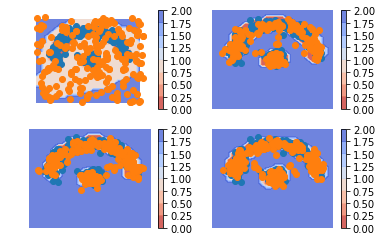

iteration  309
4.0700502 0.011599165 0.74325407 3.315197


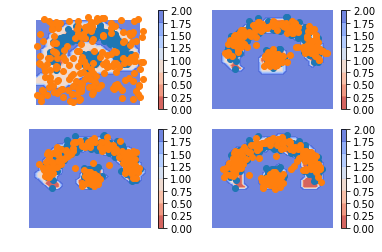

iteration  310
3.3609912 0.011682407 0.71666753 2.6326413


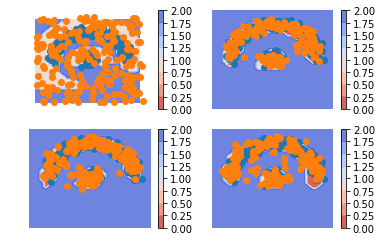

iteration  311
3.2804193 0.011807715 0.73178136 2.5368302


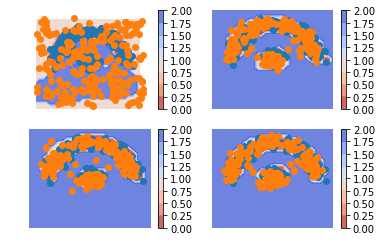

iteration  312
3.3586423 0.012206242 0.73567176 2.6107643


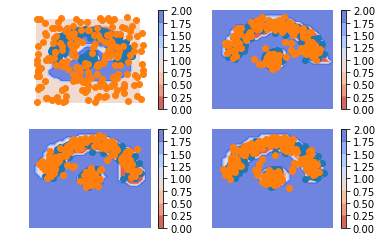

iteration  313
4.485064 0.012281256 0.74944085 3.723342


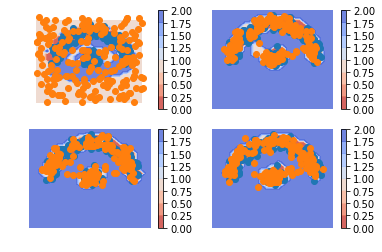

iteration  314
3.5730605 0.011439423 0.7238212 2.8377998


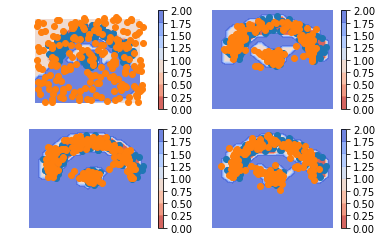

iteration  315
3.8045573 0.010282588 0.7938946 3.00038


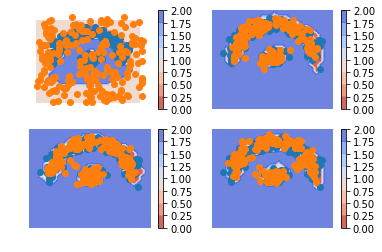

iteration  316
2.9983802 0.0093867 0.6903476 2.2986457


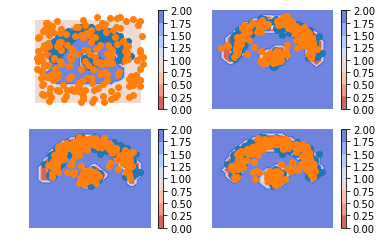

iteration  317
2.5791578 0.00868053 0.7317467 1.8387307


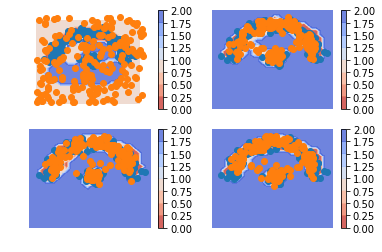

iteration  318
2.5089724 0.007762491 0.7246107 1.7765993


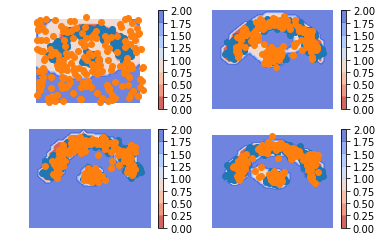

iteration  319
3.8237236 0.007574481 0.71641827 3.0997307


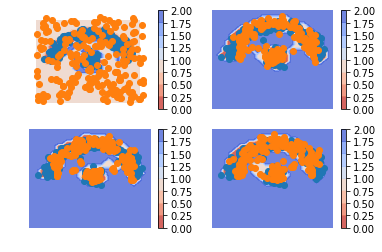

iteration  320
3.152433 0.007446246 0.67038006 2.4746068


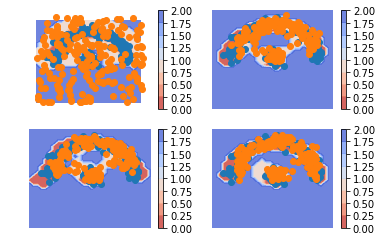

iteration  321
3.3120441 0.007401909 0.67466563 2.6299767


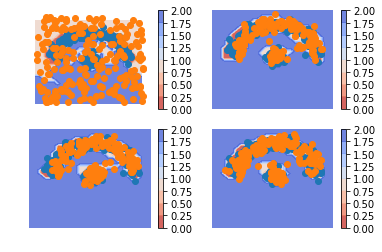

iteration  322
3.1296415 0.0077949697 0.71497726 2.4068694


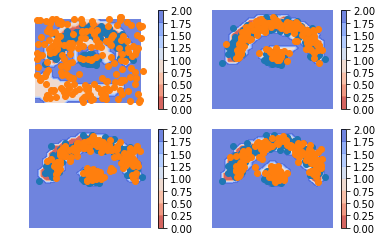

iteration  323
2.8766198 0.008184522 0.7099559 2.1584795


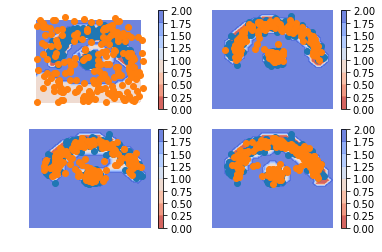

iteration  324
2.4214215 0.008725935 0.7351223 1.6775732


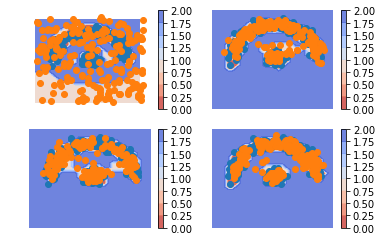

iteration  325
3.424375 0.008807508 0.726654 2.6889136


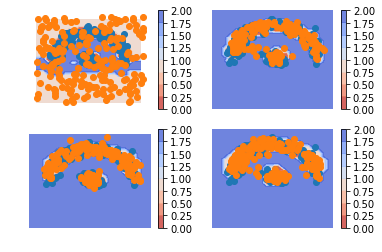

iteration  326
3.0082648 0.009105582 0.7079979 2.2911613


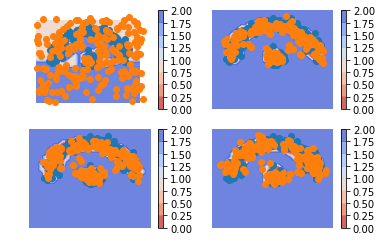

iteration  327
3.261293 0.009248609 0.737092 2.5149524


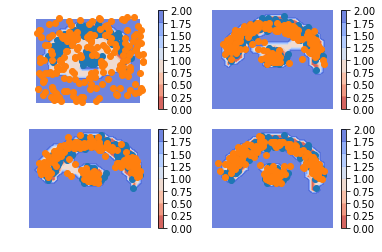

iteration  328
2.7007205 0.009203615 0.7231592 1.9683578


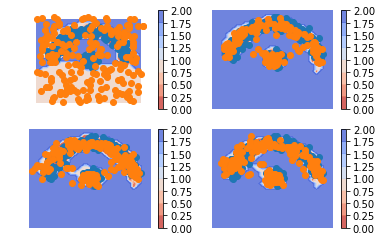

iteration  329
3.0504339 0.009572982 0.74258137 2.2982795


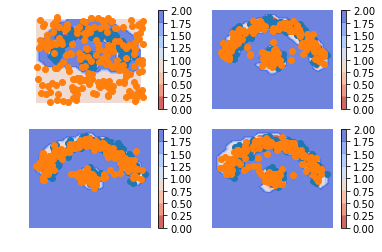

iteration  330
3.3049562 0.01013548 0.74311376 2.551707


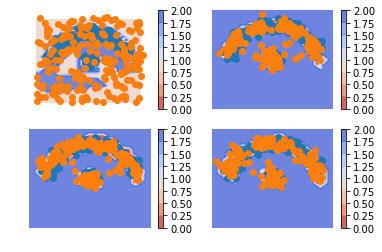

iteration  331
2.7559302 0.010796231 0.7161337 2.0290003


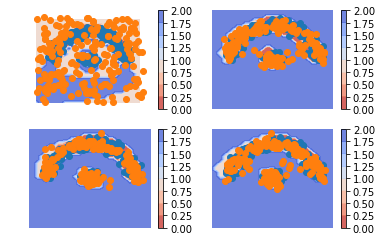

iteration  332
3.2577195 0.011396989 0.7440691 2.5022535


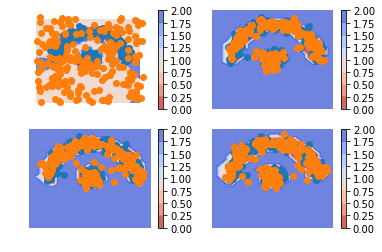

iteration  333
3.3507683 0.011913747 0.7371078 2.6017468


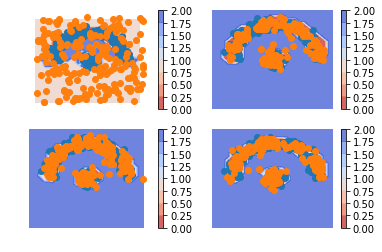

iteration  334
3.4180484 0.012906328 0.7674116 2.6377306


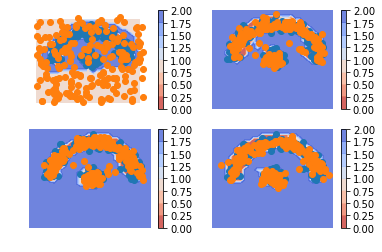

iteration  335
3.2583632 0.013690499 0.74393356 2.5007393


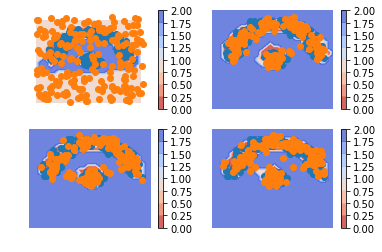

iteration  336
3.025138 0.014476189 0.7111011 2.2995605


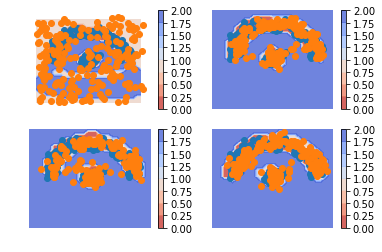

iteration  337
4.1191235 0.015343283 0.7124957 3.3912847


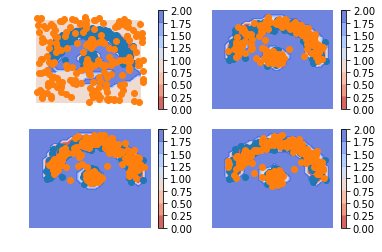

iteration  338
3.7349813 0.015577243 0.729776 2.989628


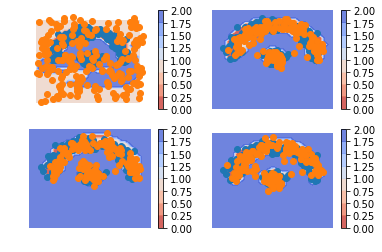

iteration  339
3.728927 0.016105816 0.71254706 3.000274


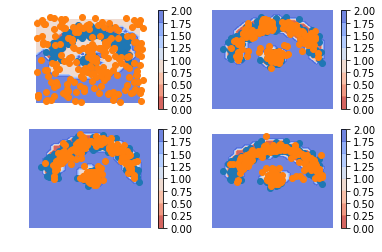

iteration  340
2.87511 0.016780408 0.73071146 2.127618


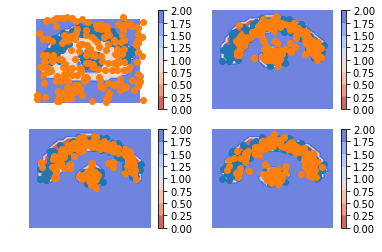

iteration  341
2.9208722 0.017848404 0.71819437 2.1848295


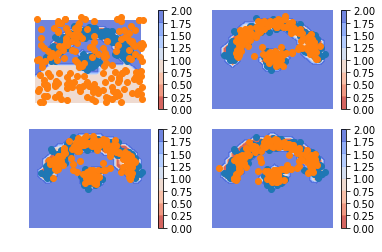

iteration  342
2.507289 0.018733695 0.70351464 1.7850407


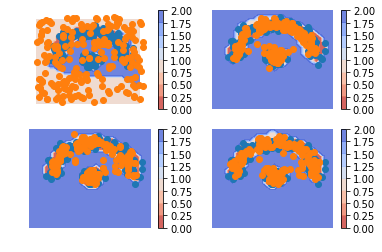

iteration  343
3.4241948 0.019855069 0.68439704 2.7199428


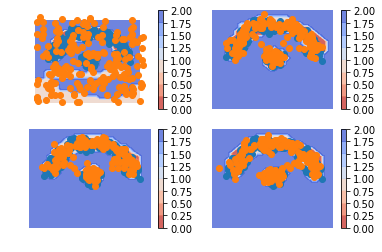

iteration  344
4.037007 0.021478338 0.72637045 3.289158


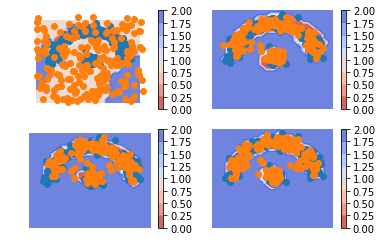

iteration  345
2.8423233 0.022768654 0.72705513 2.0924995


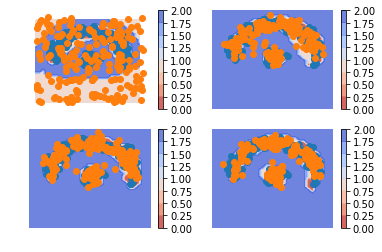

iteration  346
3.2226148 0.024126101 0.72814983 2.4703388


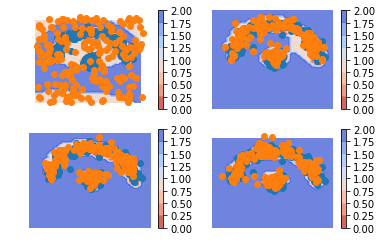

iteration  347
3.2994442 0.025594871 0.7521152 2.5217342


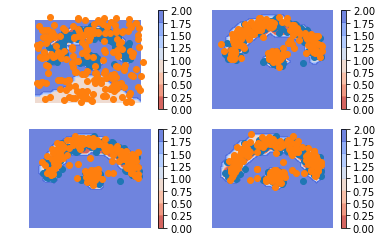

iteration  348
3.7508025 0.026735941 0.72489 2.9991765


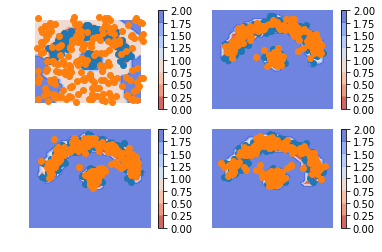

iteration  349
4.193823 0.028127773 0.71115565 3.4545393


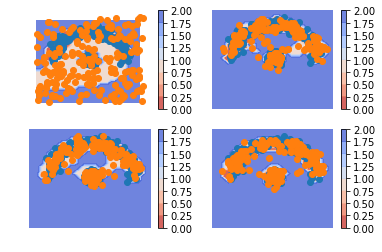

iteration  350
4.2777615 0.029401785 0.759635 3.4887247


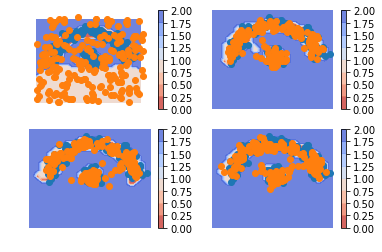

iteration  351
3.763622 0.030430311 0.7263489 3.0068429


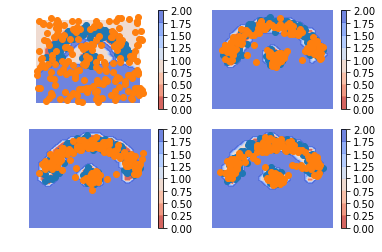

iteration  352
3.6711752 0.031298317 0.74912363 2.8907533


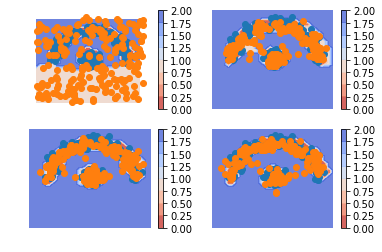

iteration  353
3.328189 0.032417003 0.708871 2.586901


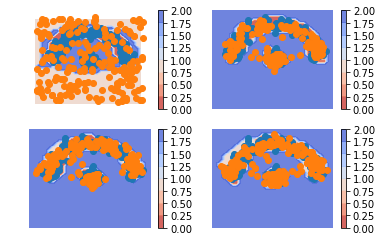

iteration  354
3.6229448 0.033002567 0.72303677 2.8669055


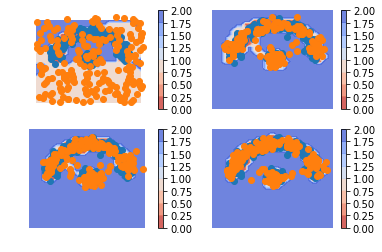

iteration  355
4.2294674 0.032106407 0.7389515 3.4584093


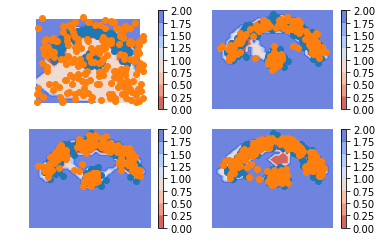

iteration  356
3.0179477 0.031640586 0.73689 2.249417


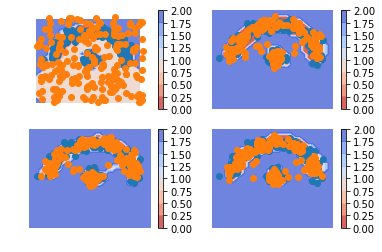

iteration  357
3.666197 0.03140819 0.7078299 2.926959


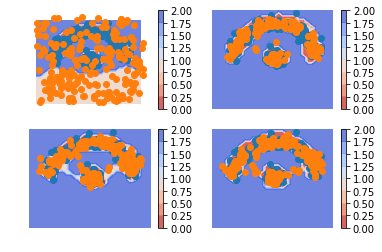

iteration  358
3.9453902 0.032074768 0.7012372 3.2120783


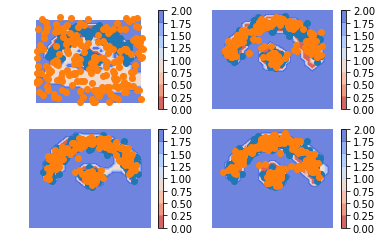

iteration  359
2.9204104 0.032183263 0.7460862 2.1421409


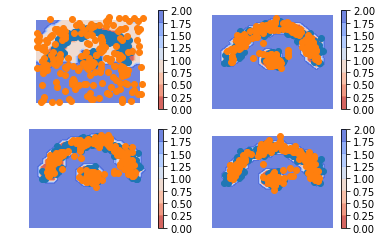

iteration  360
3.903767 0.032566164 0.72455484 3.146646


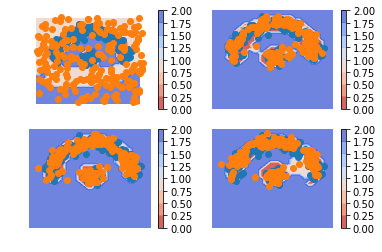

iteration  361
3.984795 0.032457504 0.7303529 3.2219846


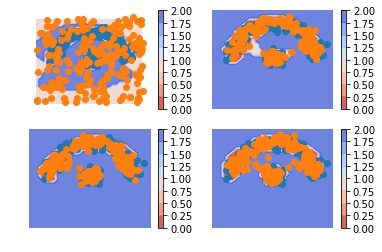

iteration  362
3.953534 0.031841382 0.7218848 3.1998076


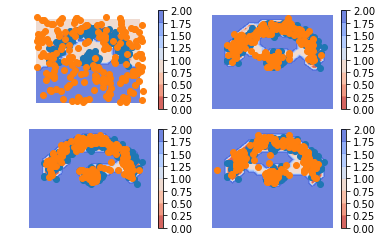

iteration  363
4.6390047 0.03063125 0.71923834 3.889135


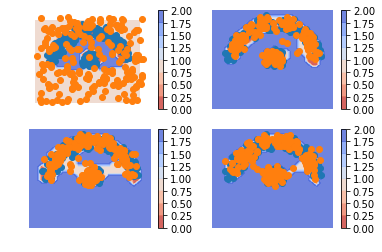

iteration  364
3.7244163 0.028839467 0.73961765 2.955959


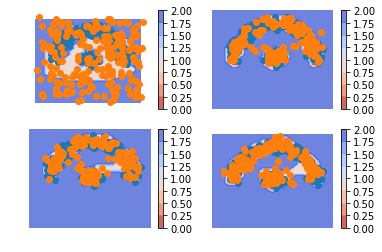

iteration  365
3.7536235 0.026406327 0.7312499 2.9959671


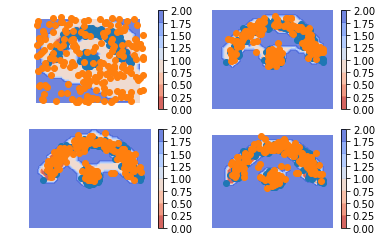

iteration  366
2.9931173 0.024246331 0.70109177 2.267779


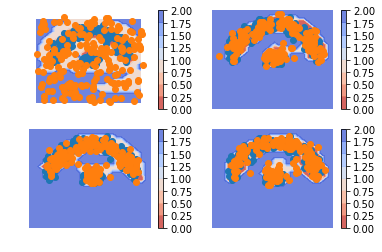

iteration  367
3.3018658 0.021999171 0.6947501 2.5851166


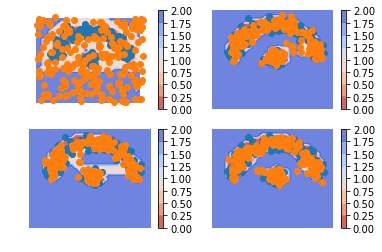

iteration  368
4.168887 0.019756826 0.6956569 3.4534733


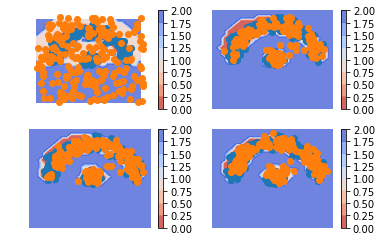

iteration  369
3.893649 0.017928734 0.6957159 3.1800044


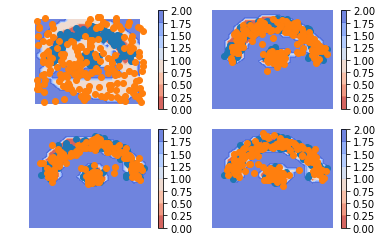

iteration  370
3.067404 0.016543398 0.72980833 2.3210523


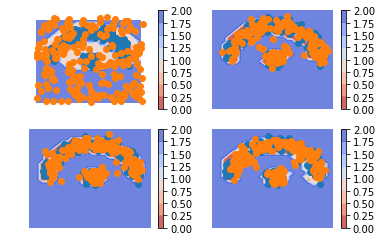

iteration  371
2.9265285 0.016054679 0.75595194 2.1545217


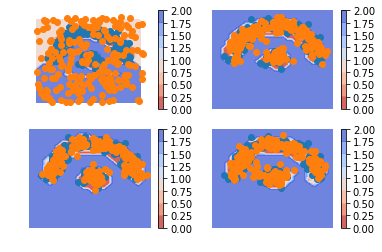

iteration  372
2.3821135 0.01578877 0.7399299 1.6263947


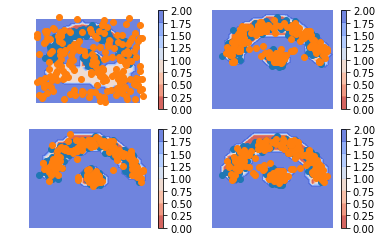

iteration  373
2.8073936 0.015328185 0.7262247 2.0658407


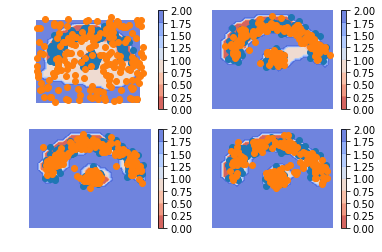

iteration  374
3.1312304 0.015276765 0.73109007 2.3848634


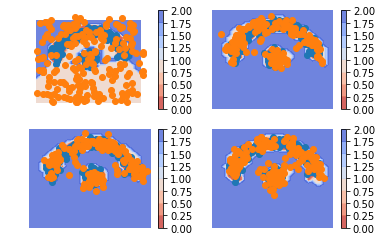

iteration  375
3.699438 0.015386338 0.74789023 2.9361615


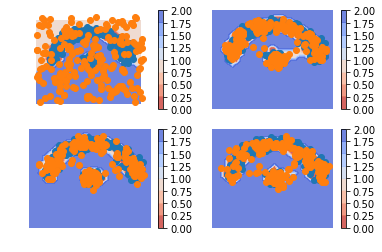

iteration  376
3.39987 0.01578002 0.74407405 2.6400158


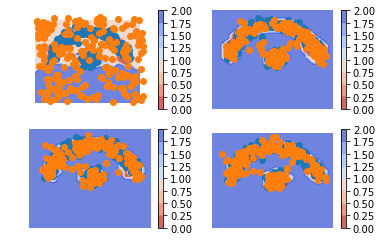

iteration  377
3.328752 0.01592118 0.7061238 2.606707


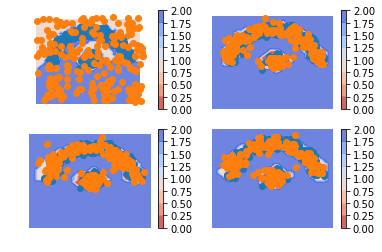

iteration  378
4.543791 0.016057199 0.7388341 3.7888997


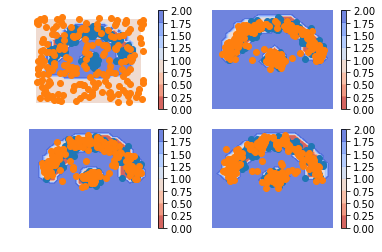

iteration  379
5.0021267 0.016252194 0.75082105 4.2350535


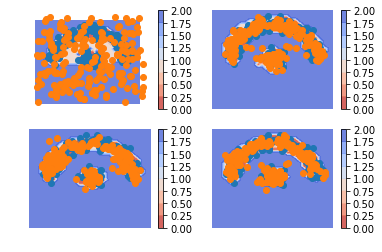

iteration  380
4.0140457 0.016605766 0.728392 3.269048


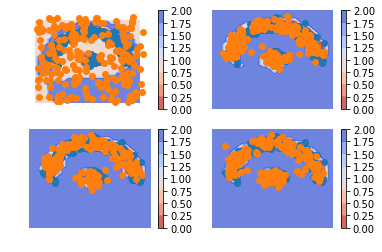

iteration  381
2.8335786 0.016912097 0.71788603 2.0987804


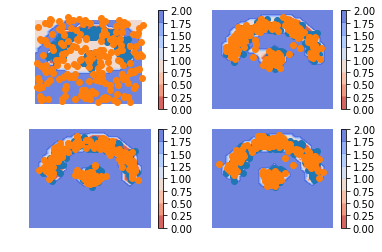

iteration  382
2.6445775 0.017319046 0.7266928 1.9005656


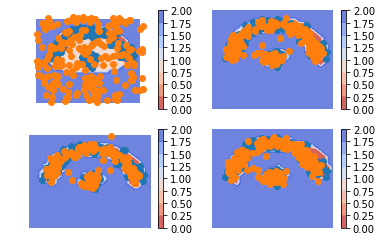

iteration  383
3.1847258 0.01733313 0.7093128 2.4580798


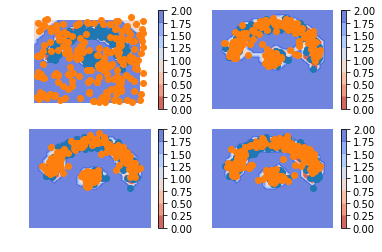

iteration  384
2.6086278 0.01750855 0.71990174 1.8712175


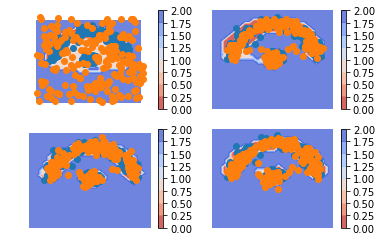

iteration  385
3.0610251 0.017538207 0.7035474 2.3399396


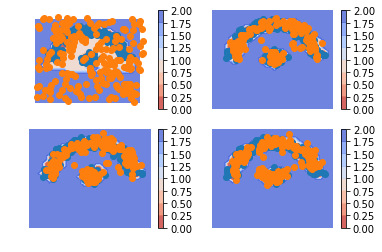

iteration  386
3.4974449 0.01769333 0.71146667 2.7682848


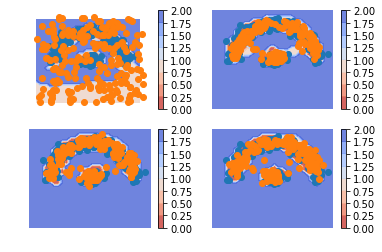

iteration  387
2.805625 0.017538814 0.68813753 2.0999486


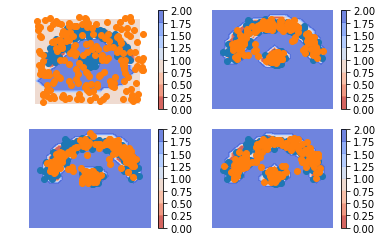

iteration  388
2.65257 0.018095495 0.66861534 1.9658592


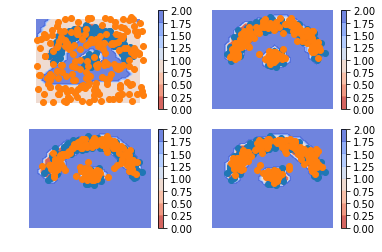

iteration  389
3.7795625 0.018982623 0.68502426 3.0755556


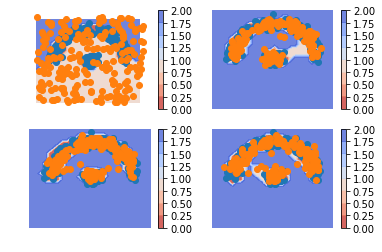

iteration  390
4.020355 0.020552523 0.74440706 3.2553954


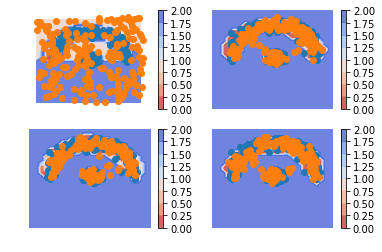

iteration  391
3.7721143 0.021975009 0.69689304 3.0532463


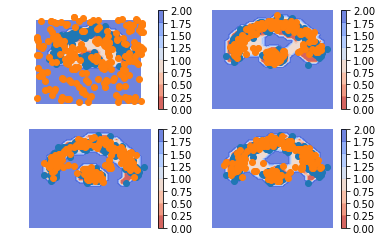

iteration  392
3.4186308 0.023813872 0.75324667 2.6415703


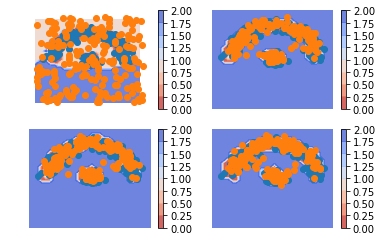

iteration  393
2.4774456 0.025592651 0.7320154 1.7198377


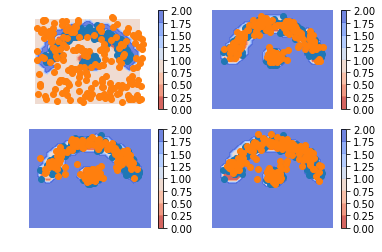

iteration  394
2.907172 0.027087064 0.7090372 2.1710477


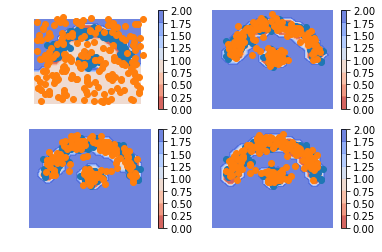

iteration  395
3.2846568 0.02885663 0.7266716 2.5291286


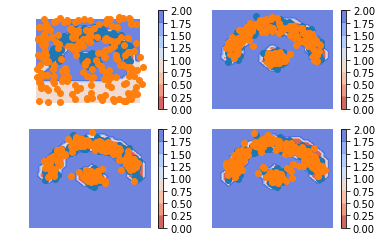

iteration  396
3.362099 0.030170575 0.76329464 2.5686338


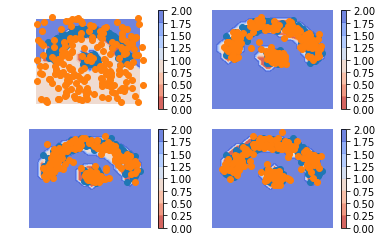

iteration  397
3.239301 0.030289462 0.775041 2.4339705


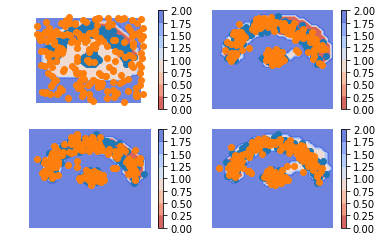

iteration  398
3.3680186 0.030231034 0.74288476 2.5949028


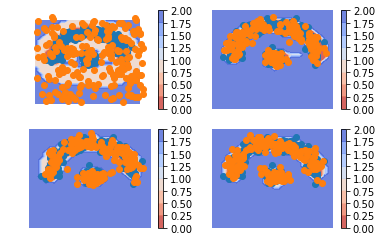

iteration  399
3.5436552 0.03027179 0.7322369 2.7811465


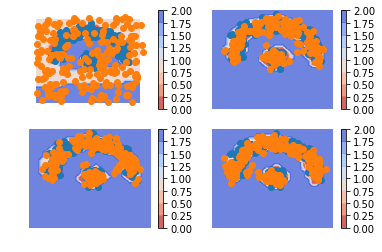

iteration  400
3.8309176 0.030832672 0.7289906 3.0710943


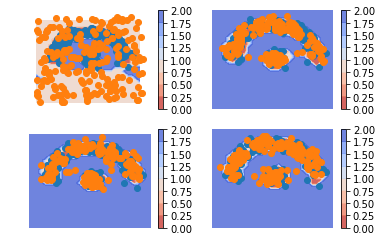

iteration  401
3.4795055 0.030905876 0.73836225 2.7102373


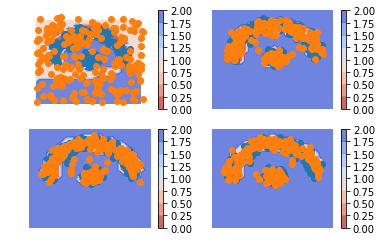

iteration  402
3.5521297 0.030759389 0.7152128 2.8061576


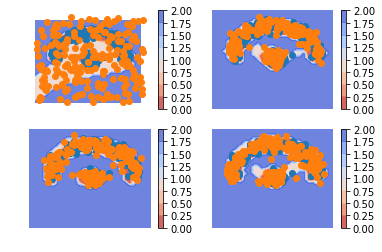

iteration  403
4.248043 0.03001308 0.73969424 3.4783359


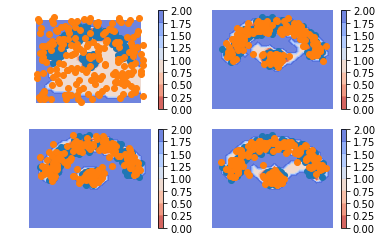

iteration  404
3.9135318 0.030502971 0.68747044 3.1955583


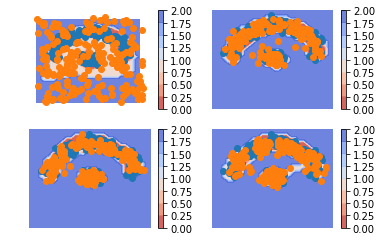

iteration  405
4.384842 0.03000535 0.7282808 3.626556


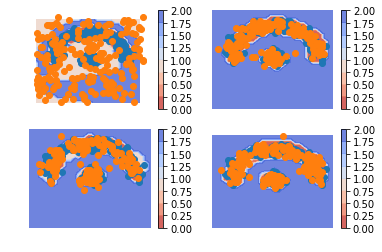

iteration  406
3.6111722 0.029050129 0.7228061 2.859316


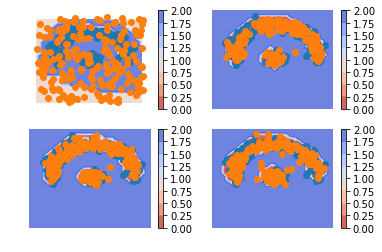

iteration  407
3.0227513 0.028602505 0.7372289 2.25692


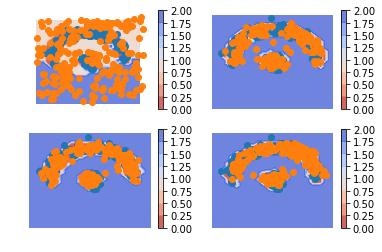

iteration  408
3.242678 0.0277764 0.7354815 2.47942


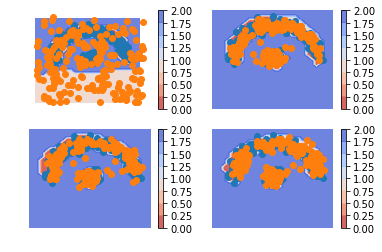

iteration  409
4.147972 0.025880301 0.7370604 3.3850312


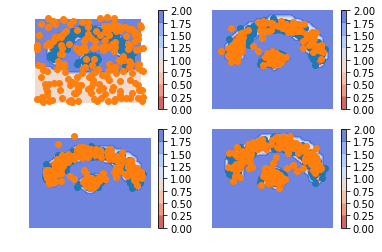

iteration  410
5.0503626 0.023876684 0.7317376 4.2947483


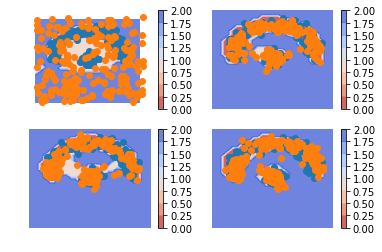

iteration  411
4.655439 0.02143491 0.76761794 3.866386


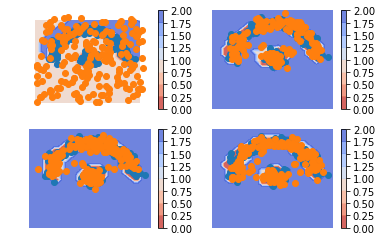

iteration  412
5.169586 0.020157494 0.744587 4.404842


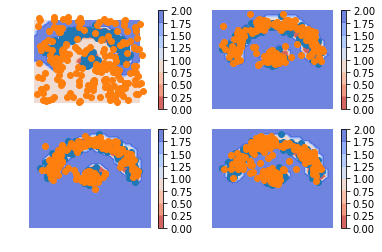

iteration  413
4.427268 0.01869958 0.72613657 3.682432


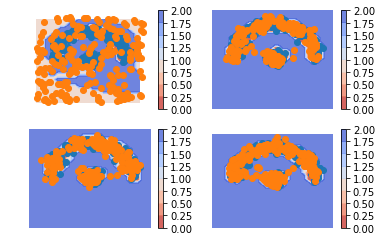

iteration  414
4.775973 0.018180607 0.7189085 4.0388837


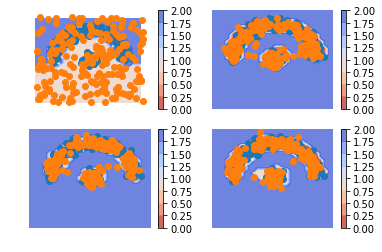

iteration  415
3.8141842 0.016240131 0.73126507 3.066679


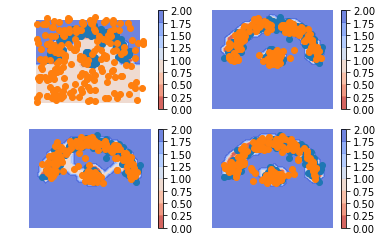

iteration  416
3.2998896 0.016021777 0.7349169 2.548951


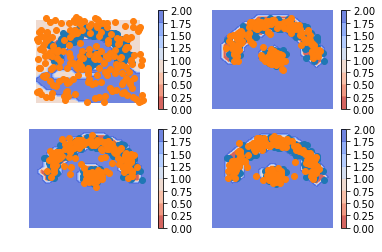

iteration  417
3.4984887 0.016133184 0.7601693 2.722186


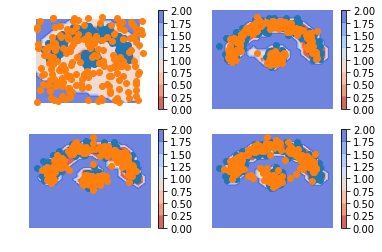

iteration  418
3.8413785 0.016820816 0.70729697 3.1172607


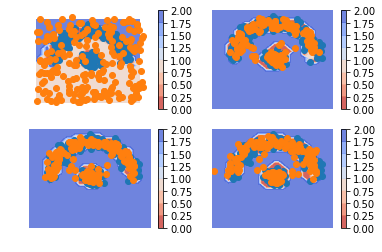

iteration  419
2.7662606 0.016123636 0.72472835 2.0254085


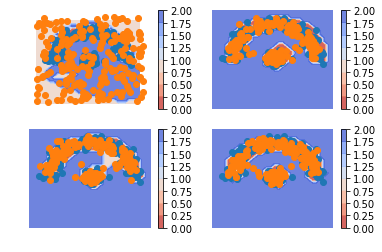

iteration  420
2.6942956 0.015914097 0.7353749 1.9430066


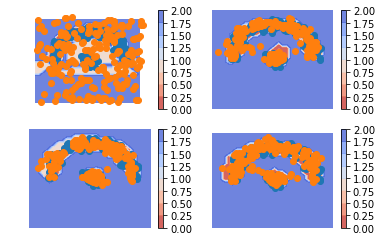

iteration  421
3.7285216 0.016181411 0.7340449 2.9782953


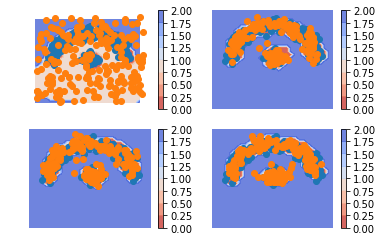

iteration  422
3.259327 0.016129253 0.7635037 2.479694


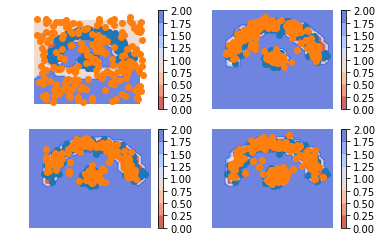

iteration  423
3.8684201 0.016124027 0.74078196 3.111514


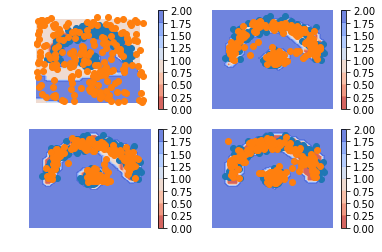

iteration  424
4.7333508 0.016016982 0.7652937 3.9520402


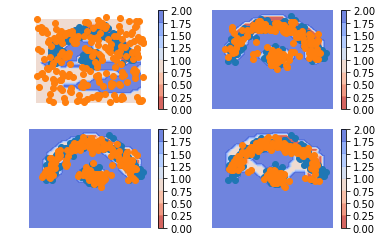

iteration  425
5.079717 0.016358199 0.7211164 4.3422427


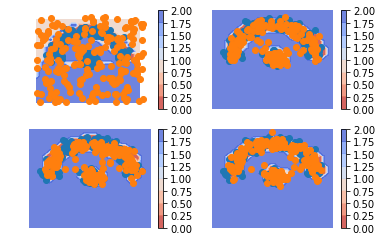

iteration  426
4.9863973 0.016190264 0.7147378 4.2554693


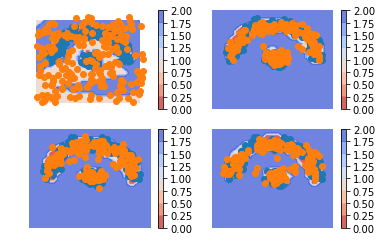

iteration  427
5.4246106 0.016733369 0.7012285 4.706649


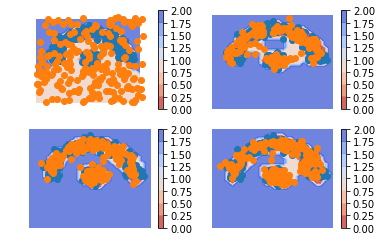

iteration  428
4.740464 0.016831992 0.74654365 3.9770887


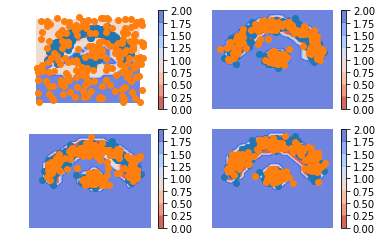

iteration  429
4.525297 0.018125828 0.75931 3.7478614


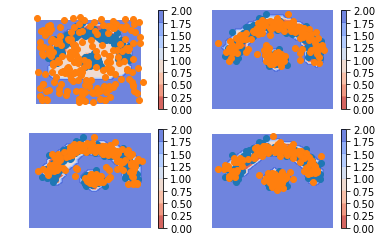

iteration  430
4.639752 0.018639125 0.7212335 3.8998792


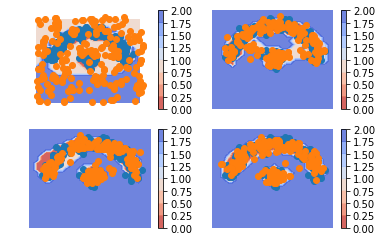

iteration  431
3.556997 0.019187301 0.705917 2.8318927


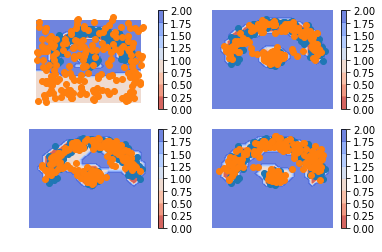

iteration  432
4.686469 0.01941909 0.72217405 3.9448762


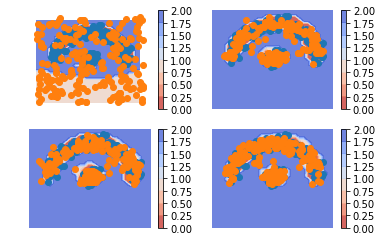

iteration  433
3.4120078 0.018461708 0.69178796 2.7017581


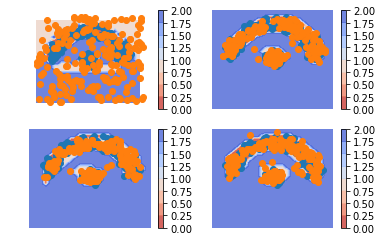

iteration  434
4.1105366 0.018319203 0.7477701 3.3444474


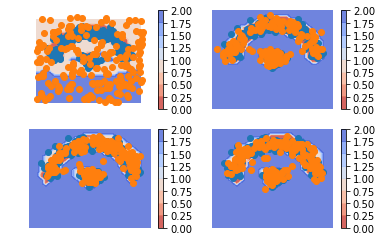

iteration  435
3.566895 0.017476436 0.713601 2.8358176


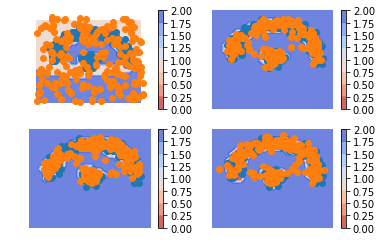

iteration  436
3.7242181 0.017306888 0.7555517 2.9513595


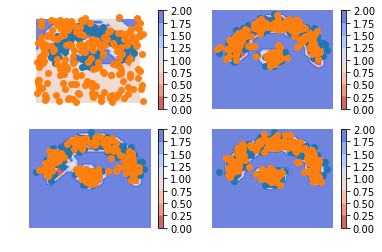

iteration  437
2.797895 0.016226206 0.72891873 2.0527499


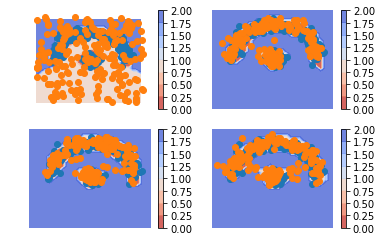

iteration  438
2.9095242 0.015326438 0.700626 2.1935718


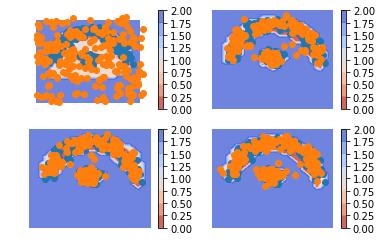

iteration  439
3.793302 0.014419371 0.75036716 3.0285156


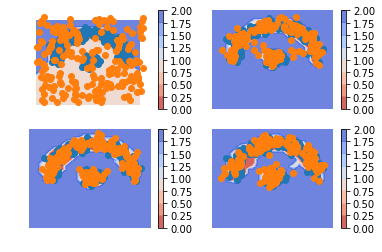

iteration  440
3.6065245 0.012987698 0.6815009 2.912036


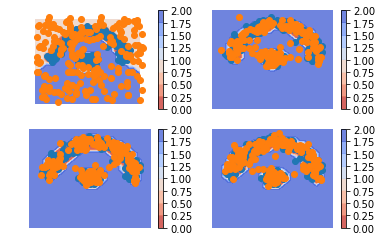

iteration  441
4.2264476 0.012035206 0.7269096 3.4875028


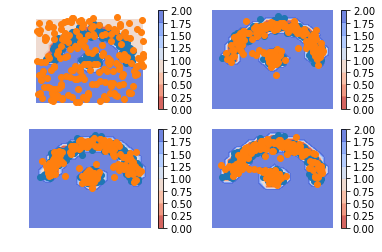

iteration  442
3.8408842 0.010827588 0.68995655 3.1401


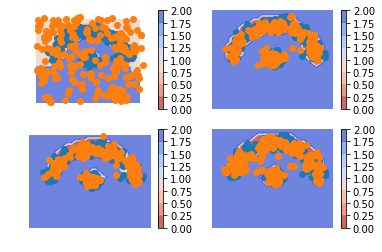

iteration  443
3.7787182 0.009918138 0.7129235 3.0558765


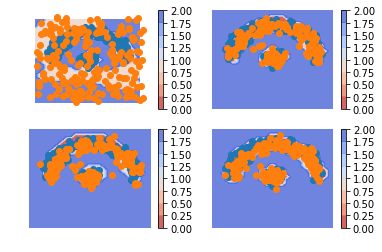

iteration  444
3.6122112 0.008631973 0.7087927 2.8947866


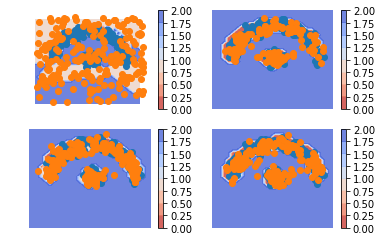

iteration  445
3.90979 0.0077743856 0.7161193 3.1858964


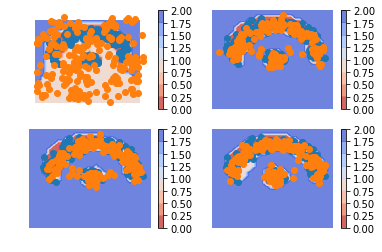

iteration  446
2.633994 0.0069282325 0.7165291 1.9105369


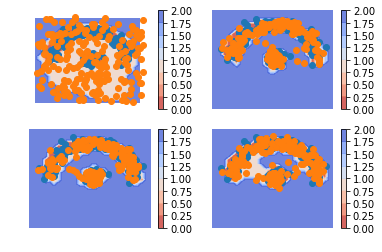

iteration  447
2.6323361 0.00635303 0.75610304 1.86988


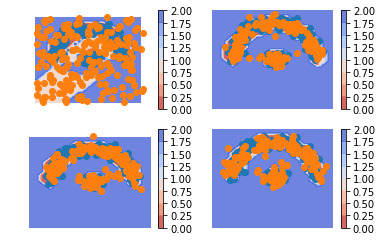

iteration  448
2.7327993 0.0058948006 0.73046 1.9964445


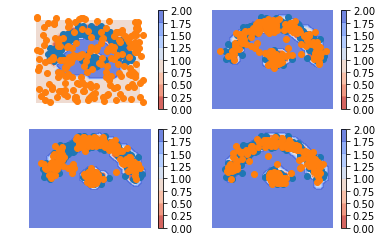

iteration  449
3.6437478 0.005394891 0.7535194 2.8848336


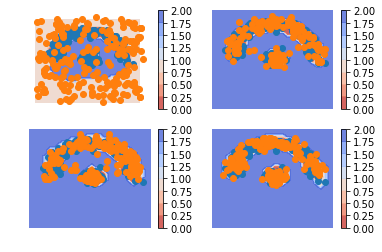

iteration  450
5.1451344 0.005285806 0.7451631 4.3946857


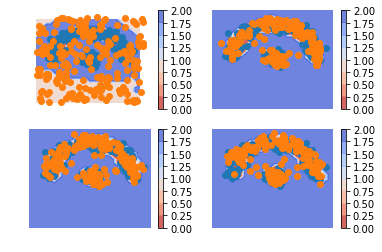

iteration  451
3.3891568 0.005316524 0.7356136 2.6482267


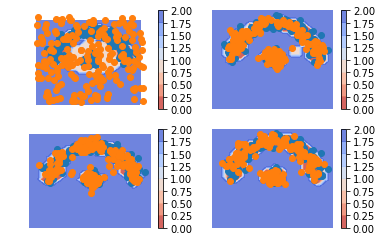

iteration  452
3.310504 0.0058092256 0.6847338 2.619961


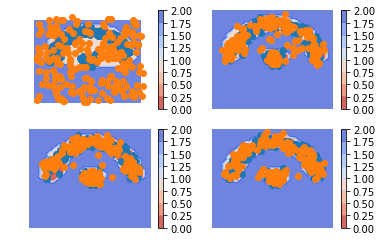

iteration  453
2.9656835 0.006589452 0.7143965 2.2446976


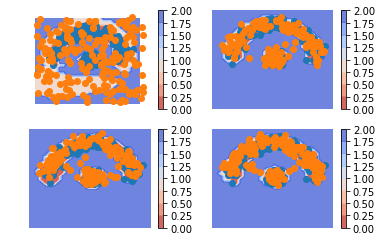

iteration  454
2.5663004 0.007163628 0.7498573 1.8092793


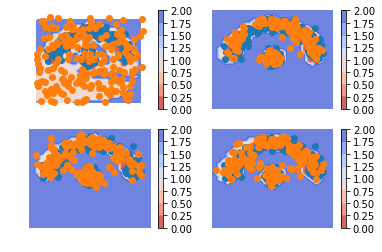

iteration  455
2.5953672 0.007902186 0.7276913 1.8597738


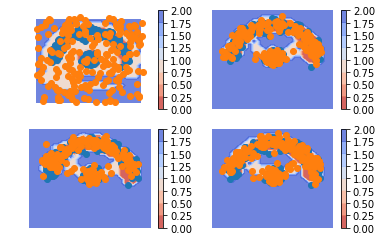

iteration  456
3.484326 0.008722431 0.71432644 2.761277


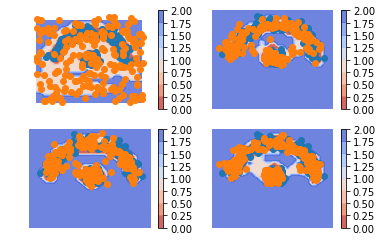

iteration  457
4.208829 0.009971391 0.72207177 3.476786


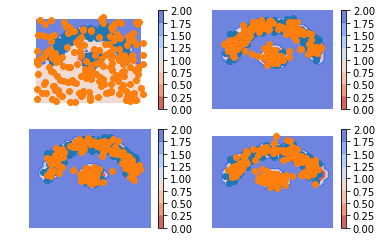

iteration  458
4.7968116 0.010480393 0.7067704 4.0795608


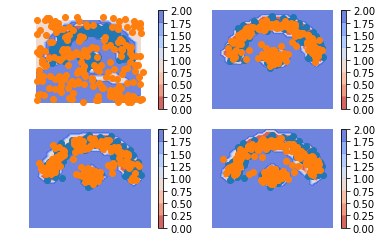

iteration  459
4.1797967 0.010782099 0.7113523 3.4576623


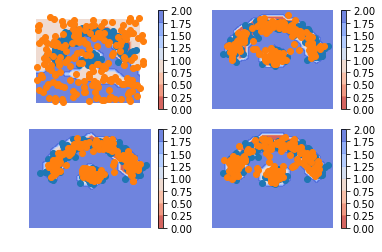

iteration  460
4.086441 0.011692459 0.70125884 3.3734899


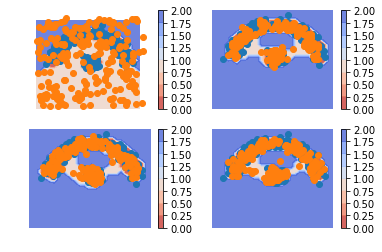

iteration  461
3.6297083 0.012606705 0.7136655 2.9034362


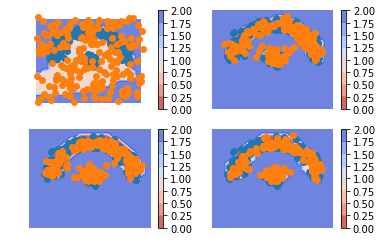

iteration  462
3.51859 0.013241304 0.75325435 2.7520943


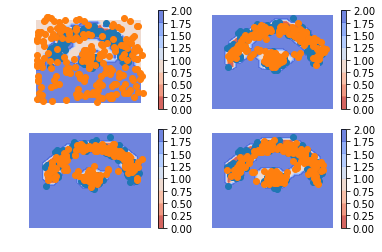

iteration  463
3.8830652 0.013998202 0.72295564 3.1461112


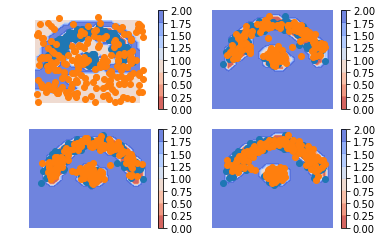

iteration  464
2.7055674 0.01471896 0.7292652 1.9615833


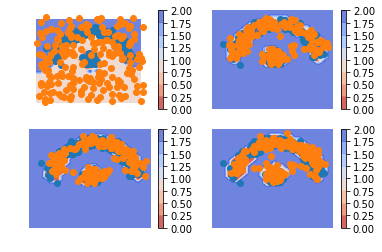

iteration  465
4.1048656 0.015247946 0.72295696 3.3666606


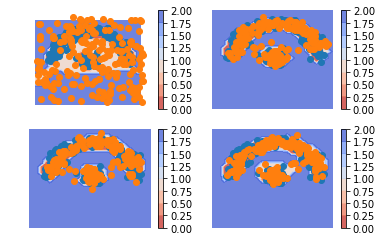

iteration  466
3.4938123 0.015781177 0.7728114 2.7052197


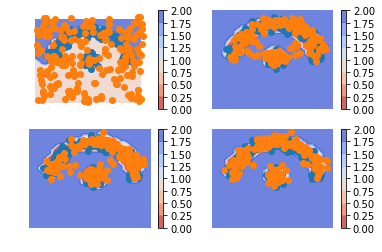

iteration  467
3.636767 0.01650086 0.7474923 2.8727736


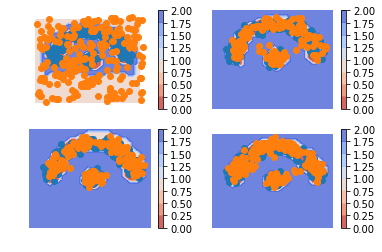

iteration  468
2.88679 0.01678029 0.7292328 2.1407769


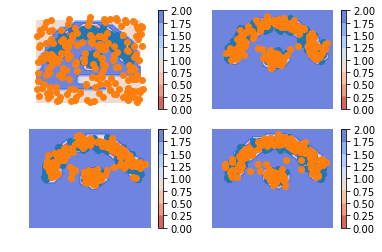

iteration  469
3.4595897 0.017083826 0.72183883 2.7206671


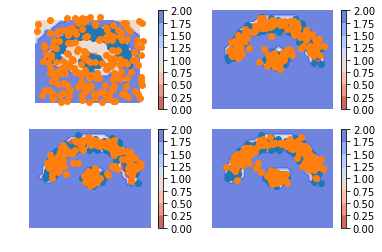

iteration  470
3.6434968 0.016450576 0.7221972 2.904849


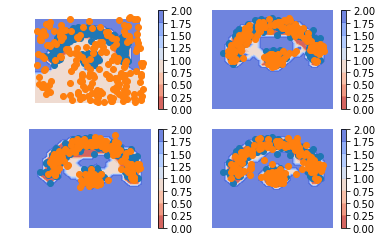

iteration  471
3.2310042 0.015798831 0.73108864 2.4841168


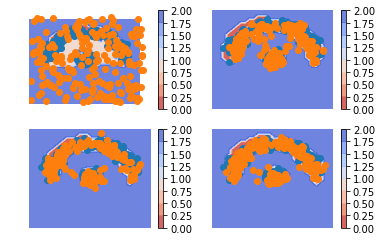

iteration  472
4.7924643 0.0154669685 0.74160725 4.03539


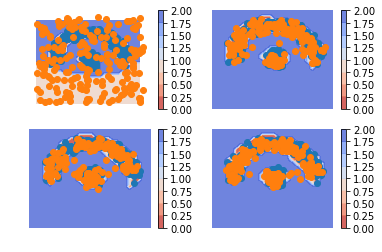

iteration  473
2.8585043 0.015086442 0.7233361 2.120082


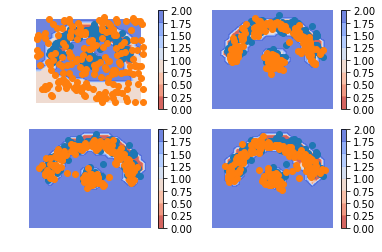

iteration  474
2.8985887 0.01504616 0.7066437 2.1768987


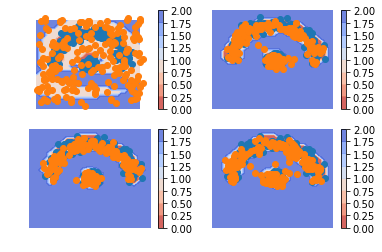

iteration  475
4.1352577 0.01522651 0.70170295 3.4183285


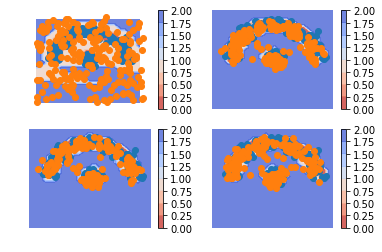

iteration  476
4.631993 0.01500179 0.7259377 3.8910534


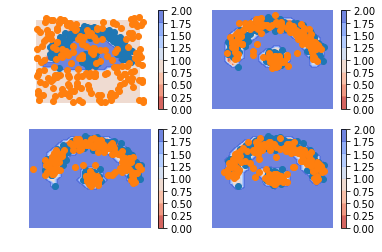

iteration  477
3.1867423 0.014774772 0.6918417 2.4801257


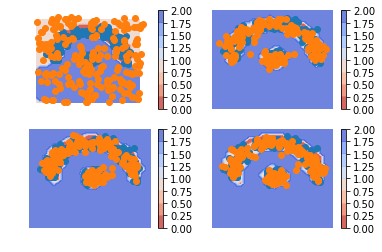

iteration  478
3.603284 0.014473963 0.76665837 2.8221517


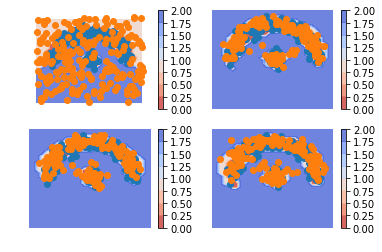

iteration  479
3.2619476 0.014877484 0.7576438 2.4894264


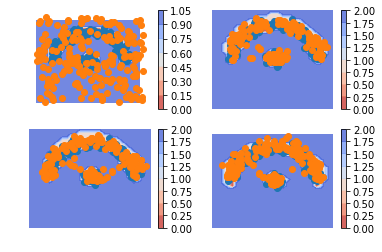

iteration  480
4.165536 0.014628358 0.7343754 3.4165323


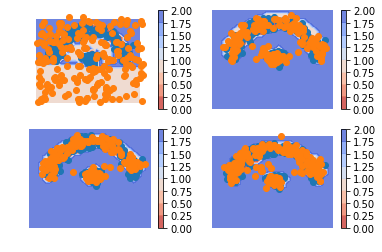

iteration  481
3.8518956 0.014825754 0.7134552 3.1236145


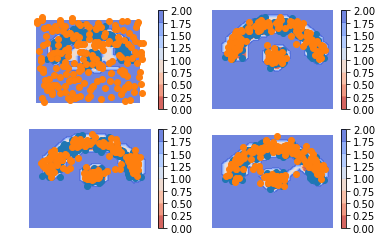

iteration  482
3.5187562 0.01549416 0.7080103 2.7952516


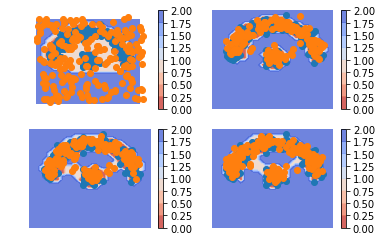

iteration  483
3.514538 0.016872518 0.7027021 2.7949634


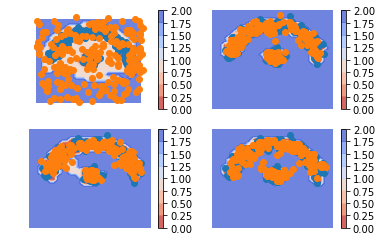

iteration  484
4.9164734 0.018291155 0.7244976 4.1736846


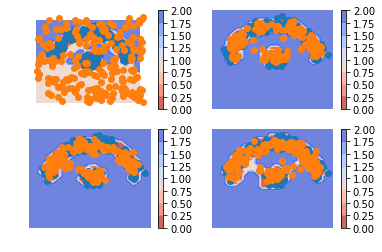

iteration  485
3.7230935 0.019573782 0.69051445 3.0130053


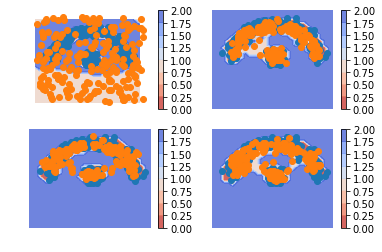

iteration  486
3.5937262 0.021500781 0.7150116 2.8572137


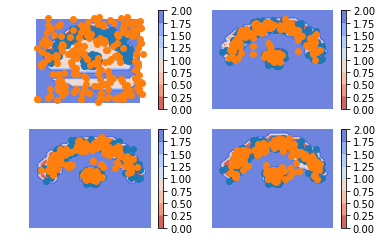

iteration  487
3.7187233 0.023038253 0.7192733 2.9764116


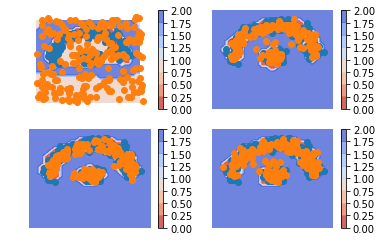

iteration  488
2.8947694 0.024158917 0.72373515 2.1468754


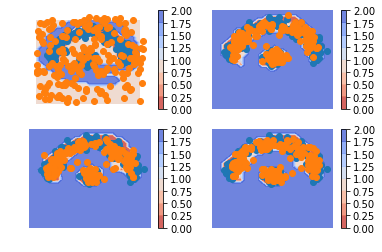

iteration  489
3.171051 0.025506828 0.71398145 2.4315627


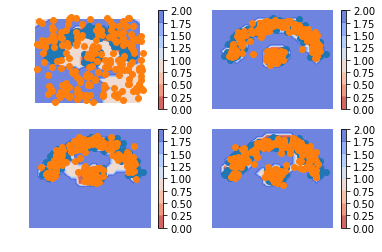

iteration  490
3.9886212 0.026085382 0.7287875 3.2337484


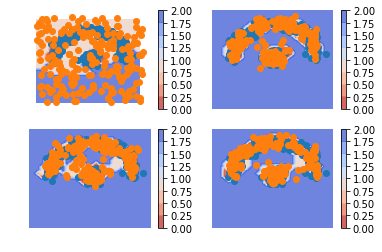

iteration  491
4.8189573 0.027130073 0.7730721 4.018755


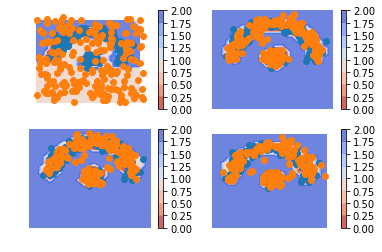

iteration  492
3.6144469 0.028221613 0.7737739 2.8124514


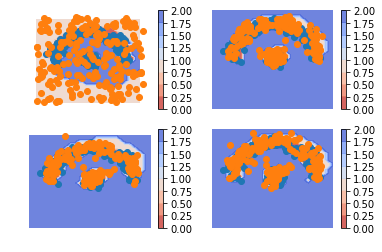

iteration  493
2.6834981 0.029503377 0.7245378 1.929457


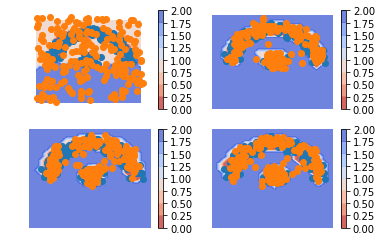

iteration  494
2.9405203 0.030391153 0.7332238 2.1769054


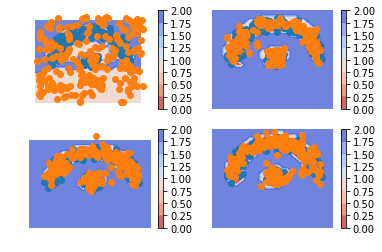

iteration  495
2.6893535 0.03100909 0.74716854 1.911176


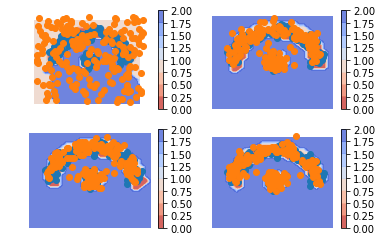

iteration  496
2.7027435 0.03139124 0.74406457 1.9272876


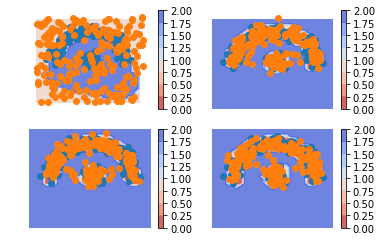

iteration  497
2.9991739 0.03129088 0.73685324 2.2310297


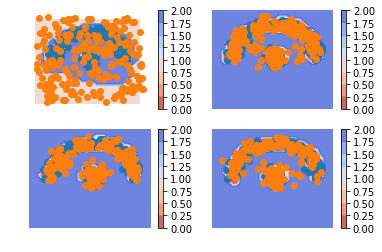

iteration  498
3.8393393 0.030602789 0.7304528 3.0782838


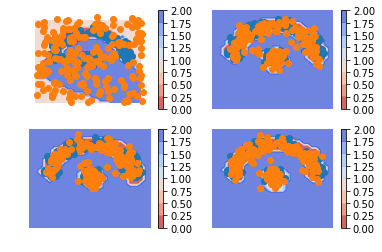

iteration  499
4.360329 0.030664448 0.72065246 3.6090121


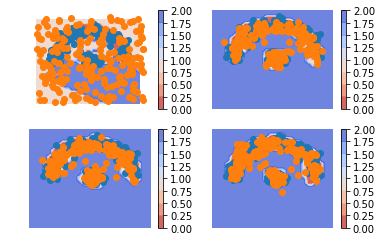

In [11]:
saver=tf.train.Saver()
with tf.Session() as sess:
    tf.global_variables_initializer().run()
    for i in range(500):
        print('iteration ',i)
        X_true=make_toy_dataset_old(200,0.1)
        X_fake=np.random.uniform(low=-1.5,high=1.5,size=(200,2))
        X_noise=np.random.uniform(low=-1.5,high=1.5,size=(200,2))
        image=np.vstack((X_true,X_fake,X_noise))
        label=np.concatenate((np.zeros(200),np.ones(200),2*np.ones(200)))
        loss_num,l1,l2,l3,i_his=sess.run([tot_loss,tot_latent_loss,tot_classifier_loss,tot_likelihood_loss,image_his],feed_dict={X:image,y:label})
        for t in range(10):
            _=sess.run([train_step1],feed_dict={X:image,y:label})
        _=sess.run([train_step2],feed_dict={X:image,y:label})
        print(loss_num,l1,l2,l3)
#         print(label)
#         print([(a.reshape(-1,)>0.5).astype(dtype=np.int32) for a in p_his])
        display(i_his,i)
        save_path = saver.save(sess, "parameters/toy/toy.ckpt")

In [12]:
'''
**************************************************************************************************************
There is a problem with classifier. 
Saparate classifier behave well, but in model it fails
**************************************************************************************************************
'''
# t=1
# plt.scatter(i_his[t][:200,0],i_his[t][:200,1])
# plt.scatter(i_his[t][200:,0],i_his[t][200:,1])
# plt.show()

# # n_out1=tf.layers.dense(X,units=100,activation=tf.nn.relu)
# # n_score=tf.layers.dense(n_out1,units=1)

# with tf.variable_scope("temp_scope") as vs:
#     classifier=Classifier()
#     n_score,prob,predict=classifier(X)

# with tf.Session() as sess:
#     tf.global_variables_initializer().run()
    
#     h=0.1
#     xx, yy = np.meshgrid(
#         np.arange(-1.5, 1.5, h),
#         np.arange(-1.5, 1.5, h))
#     points=np.c_[xx.ravel(), yy.ravel()]

#     Z=sess.run(n_score,feed_dict={X:points})
#     Z=Z.reshape(xx.shape)
#     _=plt.contourf(xx,yy,Z,cmap=plt.cm.coolwarm_r, alpha=0.8)
#     plt.scatter(i_his[t][:200,0],i_his[t][:200,1])
#     plt.scatter(i_his[t][200:,0],i_his[t][200:,1])
#     plt.axis('off')
#     plt.colorbar(_)
#     plt.show()
    

'\n**************************************************************************************************************\nThere is a problem with classifier. \nSaparate classifier behave well, but in model it fails\n**************************************************************************************************************\n'

In [13]:
a=tf.constant([[0],[1]])
b=tf.constant([[1],[2]])
d=[a,b]
c=tf.reduce_sum(d,axis=0)

with tf.Session() as sess:
    print(sess.run(d))
    print(sess.run(c))

[array([[0],
       [1]], dtype=int32), array([[1],
       [2]], dtype=int32)]
[[1]
 [3]]


INFO:tensorflow:Restoring parameters from parameters/toy/toy.ckpt


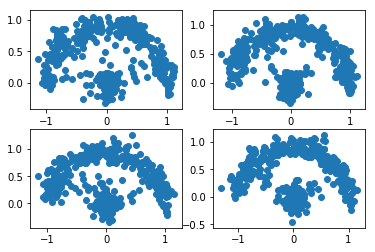

In [14]:
G_batch_size=tf.placeholder(shape=(),dtype=tf.int32,name='batch_size')
G_state_decode=vae.decoder_lstm.zero_state(G_batch_size, tf.float32)
G_unit_gaussian=tf.distributions.Normal(loc=tf.zeros((G_batch_size,vae.latent_dim)),scale=5.0*tf.ones((G_batch_size,vae.latent_dim)))

G_output_his=[]

for t in range(vae.n_time):
    G_Z=G_unit_gaussian.sample()
    with tf.variable_scope("LSTM_decoder") as vs:
        G_decode_out,G_state_decode=vae.decoder_lstm(G_Z,G_state_decode)
    G_output_image=vae.emit_net(G_decode_out)
    G_output_his.append(G_output_image)
    
with tf.Session() as sess:
    tf.global_variables_initializer().run()
    saver.restore(sess, "parameters/toy/toy.ckpt")
    output=sess.run(G_output_his,feed_dict={G_batch_size:500})
    plt.figure(1)
    for i in range(4):
        plt.subplot(2,2,i+1)
        plt.scatter(output[i][:,0],output[i][:,1])
    plt.savefig('figures/generate_result.png')
    plt.show()